# Pix2Pix : Anime Sketch Colorization

Re implementation of Pix2pix for translation image to image for Anime Sketch Colorization dataset.

Pix2pix paper : https://arxiv.org/pdf/1611.07004.pdf

dataset : https://www.kaggle.com/ktaebum/anime-sketch-colorization-pair

Auto Painter : https://arxiv.org/pdf/1705.01908.pdf

In [ ]:
!nvidia-smi

Wed Jan 13 15:21:52 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!cp "drive/MyDrive/metric.py" .

In [ ]:
! unzip "drive/MyDrive/AnimeSketchColorization-process.zip" -d .

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  inflating: ./trainData/Sketches/5499.png  
  inflating: ./trainData/Sketches/55.png  
  inflating: ./trainData/Sketches/550.png  
  inflating: ./trainData/Sketches/5500.png  
  inflating: ./trainData/Sketches/5501.png  
  inflating: ./trainData/Sketches/5502.png  
  inflating: ./trainData/Sketches/5503.png  
  inflating: ./trainData/Sketches/5504.png  
  inflating: ./trainData/Sketches/5505.png  
  inflating: ./trainData/Sketches/5506.png  
  inflating: ./trainData/Sketches/5507.png  
  inflating: ./trainData/Sketches/5508.png  
  inflating: ./trainData/Sketches/5509.png  
  inflating: ./trainData/Sketches/551.png  
  inflating: ./trainData/Sketches/5510.png  
  inflating: ./trainData/Sketches/5511.png  
  inflating: ./trainData/Sketches/5512.png  
  inflating: ./trainData/Sketches/5513.png  
  inflating: ./trainData/Sketches/5514.png  
  inflating: ./trainData/Sketches/5515.png  
  inflating: ./trainData/S

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F 
import numpy as np
from metric import FID
from tqdm.autonotebook import tqdm 
from torch.utils.data import DataLoader
import torchvision

# Generator

The generator is based on the Unet Architecture, with an encoder and a decoder part.

![image](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/u-net-architecture.png)

The input is the "condition image". The output is the image generated from the condition image.

We can use the Unet Architecture, but instead of using MaxPool, we will use striding=2.

In [ ]:
class ConvBlock(torch.nn.Module):
    def __init__(self, input_size, output_size, kernel_size=4, stride=2, padding=1, activation=True, batch_norm=True):
        super(ConvBlock, self).__init__()
        self.conv = torch.nn.Conv2d(input_size, output_size, kernel_size, stride, padding)
        self.activation = activation
        self.lrelu = torch.nn.LeakyReLU(0.2, True)
        self.batch_norm = batch_norm
        self.bn = torch.nn.BatchNorm2d(output_size)

    def forward(self, x):
        x = self.conv(x)

        if self.batch_norm:
            out = self.bn(x)
        else:
            out = x

        if self.activation:
            return self.lrelu(out)
        else:
            return out


class DeconvBlock(torch.nn.Module):
    def __init__(self, input_size, output_size, kernel_size=4, stride=2, padding=1, batch_norm=True, activation=True):
        super(DeconvBlock, self).__init__()
        self.deconv = torch.nn.ConvTranspose2d(input_size, output_size, kernel_size, stride, padding)
        self.bn = torch.nn.BatchNorm2d(output_size)
        self.relu = torch.nn.LeakyReLU(0.2, True)#torch.nn.ReLU(True)#
        self.batch_norm = batch_norm
        self.activation = activation

    def forward(self, x):
        out = self.deconv(x)

        if self.batch_norm:
            out = self.bn(out)
       

        if self.activation:
          out = self.relu(out)

        return out
class Pix2PixGen(torch.nn.Module):
    def __init__(self, in_channels, num_filter=64, classes=4):
        super(Pix2PixGen, self).__init__()

        # Encoder
        self.conv1 = ConvBlock(in_channels, num_filter, activation=False, batch_norm=False)
        self.conv2 = ConvBlock(num_filter, num_filter * 2)
        self.conv3 = ConvBlock(num_filter * 2, num_filter * 4)
        self.conv4 = ConvBlock(num_filter * 4, num_filter * 8)
        self.conv5 = ConvBlock(num_filter * 8, num_filter * 8)
        self.conv6 = ConvBlock(num_filter * 8, num_filter * 8)
        self.conv7 = ConvBlock(num_filter * 8, num_filter * 8)
        self.conv8 = ConvBlock(num_filter * 8, num_filter * 8, batch_norm=False)
        # Decoder
        self.deconv1 = DeconvBlock(num_filter * 8, num_filter * 8)
        self.deconv2 = DeconvBlock(num_filter * 8 * 2, num_filter * 8)
        self.deconv3 = DeconvBlock(num_filter * 8 * 2, num_filter * 8)
        self.deconv4 = DeconvBlock(num_filter * 8 * 2, num_filter * 8)
        self.deconv5 = DeconvBlock(num_filter * 8 * 2, num_filter * 4)
        self.deconv6 = DeconvBlock(num_filter * 4 * 2, num_filter * 2)
        self.deconv7 = DeconvBlock(num_filter * 2 * 2, num_filter)
        self.deconv8 = DeconvBlock(num_filter * 2, classes, batch_norm=False, activation=False)

    def forward(self, x):
        # Encoder
        enc1 = self.conv1(x)
        enc2 = self.conv2(enc1)
        enc3 = self.conv3(enc2)
        enc4 = self.conv4(enc3)
        enc5 = self.conv5(enc4)
        enc6 = self.conv6(enc5)
        enc7 = self.conv7(enc6)
        enc8 = self.conv8(enc7)
        # Decoder with skip-connections
        dec1 = self.deconv1(enc8)
        dec1 = torch.cat([dec1, enc7], 1)
        dec2 = self.deconv2(dec1)
        dec2 = torch.cat([dec2, enc6], 1)
        dec3 = self.deconv3(dec2)
        dec3 = torch.cat([dec3, enc5], 1)
        dec4 = self.deconv4(dec3)
        dec4 = torch.cat([dec4, enc4], 1)
        dec5 = self.deconv5(dec4)
        dec5 = torch.cat([dec5, enc3], 1)
        dec6 = self.deconv6(dec5)
        dec6 = torch.cat([dec6, enc2], 1)
        dec7 = self.deconv7(dec6)
        dec7 = torch.cat([dec7, enc1], 1)
        dec8 = self.deconv8(dec7)
        out = torch.nn.Tanh()(dec8)
        return out

    def normal_weight_init(self, mean=0.0, std=0.02):
        for m in self.children():
            if isinstance(m, ConvBlock):
                torch.nn.init.normal(m.conv.weight, mean, std)
            if isinstance(m, DeconvBlock):
                torch.nn.init.normal(m.deconv.weight, mean, std)


# Discriminator : Patch GAN



The input is the concatenation of the "condition image" and the real/generated images. The output is a feature maps (patch of pixels) whose each pixels is a prediction fake/real.

In [ ]:
class Pix2PixDisc(nn.Module):
    # initializers
    def __init__(self, d=16, in_channels=4, classes=1):
        super(Pix2PixDisc, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, d, 4, 2, 1)
        self.conv2 = nn.Conv2d(d, d * 2, 4, 2, 1)
        self.conv2_bn = nn.BatchNorm2d(d * 2)
        self.conv3 = nn.Conv2d(d * 2, d * 4, 4, 2, 1)
        self.conv3_bn = nn.BatchNorm2d(d * 4)
        self.conv4 = nn.Conv2d(d * 4, d * 8, 4, 1, 1)
        self.conv4_bn = nn.BatchNorm2d(d * 8)
        self.conv5 = nn.Conv2d(d * 8, classes, 4, 1, 1)

    # weight_init
    def weight_init(self, mean, std):
        for m in self._modules:
            normal_init(self._modules[m], mean, std)

    # forward method
    def forward(self, input):
        x = input
        x = F.leaky_relu(self.conv1(x), 0.2)
        x = F.leaky_relu(self.conv2_bn(self.conv2(x)), 0.2)
        x = F.leaky_relu(self.conv3_bn(self.conv3(x)), 0.2)
        x = F.leaky_relu(self.conv4_bn(self.conv4(x)), 0.2)
        x = self.conv5(x)
        x = torch.sigmoid(x)
        #print(x.shape)
        x = x.view(x.shape[0], -1).mean(1)
        return x

# Loss

The loss of the generator can be composed into two parts: 
- conditional GAN loss whose goal is to fool the discriminator when fake images are generated : $\mathbb{E}_{x, z}[\log (1-D(G(x, z))]$ . We can use BCE loss for this part.
- the reconstruction loss to improve the quality of the generator : $\mathcal{L}_{L 1}(G)=\mathbb{E}_{x, y, z}\left[\|y-G(x, z)\|_{1}\right]$. We can use the L1 loss.

The discriminator use the same loss as a regular GAN.
The standard loss can be rewritten : $G^{*}=\arg \min _{G} \max _{D} \mathcal{L}_{c G A N}(G, D)+\lambda \mathcal{L}_{L 1}(G)$ with : 

$\begin{aligned} \mathcal{L}_{c G A N}(G, D)=& \mathbb{E}_{x, y}[\log D(x, y)]+  \mathbb{E}_{x, z}[\log (1-D(x, G(x, z))]\end{aligned}$

We can also add two loss function for our purpose : colorize sketch from japanese anime. These function were mentionned in the paper auto-painter : 

- the feature loss which try to minimize the high-level feature of the image target and image generated using the 4th layer of a VGG16 pretrained-model. The loss used is L2 (RMSE)
- the total variation loss is used to avoid a color mutation in the generated image. The total variation loss can constrain the pixel changes in  the  generated results and encourages smoothness. $L_{l v}=\sqrt{\left(y_{i+1, j}-y_{i, j}\right)^{2}+\left(y_{i, j+1}-y_{i, j}\right)^{2}}$

In [ ]:
# loss generator
# BCE + regularization L1
def get_gen_loss(preds_fake, alpha, real_img, fake_img):
  loss_gen = bceloss(preds_fake, torch.ones_like(preds_fake))#nn.BCELoss()(preds_fake, torch.ones_like(preds_fake))
  loss_reconstruction = nn.L1Loss()(fake_img, real_img)

  return loss_gen + alpha * loss_reconstruction


In [ ]:
def RMSELoss(yhat,y, eps=1e-8):
    return torch.mean(torch.sqrt( ((yhat-y)**2) + eps ))

def features_loss(fake, real, vgg, alpha=0.1):
  features_fake = vgg(nn.functional.interpolate(fake, (224, 224) ))
  features_real = vgg(nn.functional.interpolate(real, (224, 224) ))

  return alpha * RMSELoss(features_fake, features_real)

In [ ]:
def total_variation_loss(fake, alpha=1e-2):
  bs, c, h, w = fake.shape
  var_h = torch.pow(fake[:,:,1:,:] - fake[:,:,:-1,:], 2).view(-1)
  var_w = torch.pow(fake[:,:,:,1:] - fake[:,:,:,:-1], 2).view(-1)

  loss = (var_h.sum() + var_w.sum())
  return alpha * torch.sqrt(loss)


In [ ]:
# loss discriminator
def get_disc_loss(real, fake):
  return (bceloss(fake, torch.zeros_like(fake)) + bceloss(real, torch.ones_like(real)))/2.0

# VGG16 for computing total variation loss


In [ ]:
# VGG16 for computing loss
vgg = torchvision.models.vgg16(pretrained=True).features[:9]

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


In [ ]:
vgg

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
)

# Dataset

In [ ]:
import cv2
from torch.utils.data import Dataset

def to_image_mat(x):
  # -1, 1
  return (x+1)/2.0

class AnimePairDataset(Dataset):
    """Anime Sketch Colorization dataset."""

    def __init__(self, images_path, sketch_path):
        self.sketch_path = sketch_path
        self.images_path = images_path

    def __len__(self):
        return len(self.sketch_path)

    def __getitem__(self, idx):
      sketch = (torch.as_tensor( cv2.imread(self.sketch_path[idx])[:,:,::-1].copy() )-127.5)/127.5
      image = (torch.as_tensor( cv2.imread(self.images_path[idx])[:,:,::-1].copy() )-127.5)/127.5
      image = image.permute(2,0,1)
      sketch = sketch.permute(2,0,1)

      return sketch, image

# training utils

In [ ]:
from torchvision.utils import make_grid
from matplotlib import pyplot as plt
def show_tensor_images(image_tensor, num_images=4, size=(3, 256, 256), display=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    if display:
      plt.figure(figsize=(15,15))
      plt.imshow(image_grid.permute(1, 2, 0).squeeze())
      plt.show()
    return image_grid.permute(1,2,0).numpy()


In [ ]:
def create_inputs_disc(img, condition_img):
  """
    concat the generated image or the real image WITH the sketch image
  """
  return torch.cat([img, condition_img], dim=1)

In [ ]:
def bceloss( predicted, actual,  eps=1e-5, display=False):

        """
        :param predicted:   The predicted probabilities as floats between 0-1
        :param actual:      The binary labels. Either 0 or 1.
        :param eps:         Log(0) is equal to infinity, so we need to offset our predicted values slightly by eps from 0 or 1
        :return:            The logarithmic loss between between the predicted probability assigned to the possible outcomes for item i, and the actual outcome.
        """

       # print("preds:", predicted)
       # print("target", actual)
        p1 = actual * torch.log(torch.clamp(predicted, 0.0+eps, 1.0-eps))
        p0 = (1-actual) * torch.log( torch.clamp(1- predicted, 0.0+eps, 1.0-eps))
        loss = p0 + p1
        if display:
            print("p1 : ", p1, "\n p0 : ", p0)
        return -loss.mean()

In [ ]:
def inference(gen, dataset, ids, device):
  """
    generate colorization image from sketch based on their ids in the dataset
  """
  conds = []
  reals = []
  for i in ids:
    o = dataset[i]
    conds.append(o[0])
    reals.append(o[1])
  conds = torch.stack(conds)
  reals = torch.stack(reals)
  fakes = gen(conds.to(device))
  fakes = fakes.detach().cpu() 
  reals = reals.cpu() 
  conds = conds.cpu() 
  return conds, reals, fakes

In [ ]:
def evaluate(gen, val_dataloader, fid):
  features_r = []
  features_g = []
  for conditions, reals in tqdm(val_dataloader):
    conditions = nn.functional.interpolate(conditions, resize)
    reals = nn.functional.interpolate(reals, resize)
    conditions = conditions.to(device)
    reals = reals.to(device)
    with torch.no_grad():
      fakes = gen(conditions)

      feats_r, feats_g = fid.extract_features(fakes, reals)
      features_r.append(feats_r.detach().cpu().numpy())
      features_g.append(feats_g.detach().cpu().numpy())

  features_r = np.concatenate(features_r)
  features_g = np.concatenate(features_g)

  results = fid(torch.as_tensor(features_r), torch.as_tensor(features_g))
  return results.cpu().numpy()

# Train

In [ ]:

epochs = 100
device = "cuda"
batch_size = 32
resize = 512
alpha = 100
evaluation_every_e = 1
alpha_features = 1e-2
alpha_variation = 1e-4

In [ ]:
fid = FID(device)

Downloading: "https://download.pytorch.org/models/inception_v3_google-1a9a5a14.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-1a9a5a14.pth


In [ ]:
gen = Pix2PixGen( in_channels=3, num_filter=64, classes=3).to(device) 
disc = Pix2PixDisc(d=16, in_channels=6, classes=1).to(device)
# gen.load_state_dict(torch.load("drive/MyDrive/pix2pixgen.pth"))
# disc.load_state_dict(torch.load("drive/MyDrive/pix2pixdisc.pth"))

optimizer_gen = torch.optim.Adam(gen.parameters(), lr=1e-3, betas=(0.5, 0.999),)
optimizer_disc = torch.optim.Adam(disc.parameters(), lr=2e-4, betas=(0.5, 0.999),)
vgg = vgg.to(device)

In [ ]:
import os
train_sketch = [os.path.join("trainData/Sketches" , x) for x in sorted(os.listdir("trainData/Sketches"))]
train_images = [os.path.join("trainData/Images" , x) for x in sorted(os.listdir("trainData/Images"))]
val_sketch = [os.path.join("valData/Sketches" , x) for x in sorted(os.listdir("valData/Sketches"))]
val_images = [os.path.join("valData/Images" , x) for x in sorted(os.listdir("valData/Images"))]

In [ ]:
dataset = AnimePairDataset(train_images, train_sketch)
val_dataset = AnimePairDataset(val_images, val_sketch)

dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=4)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=1)


Num epochs : 1


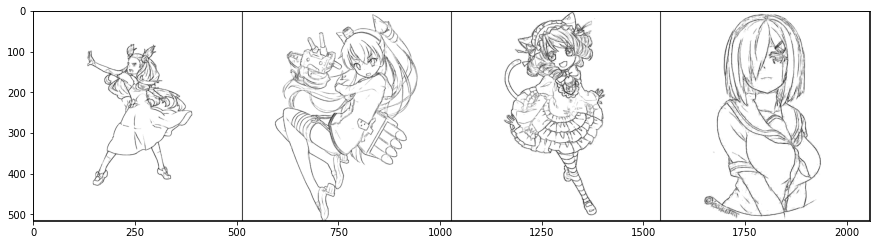

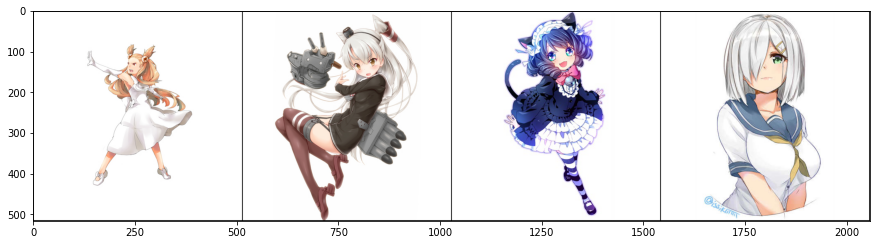

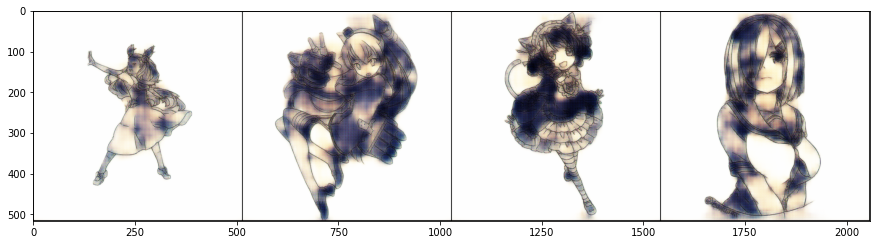


FID :  85.39746



Num epochs : 2


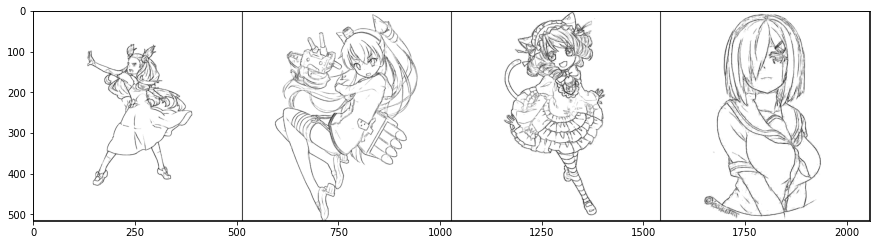

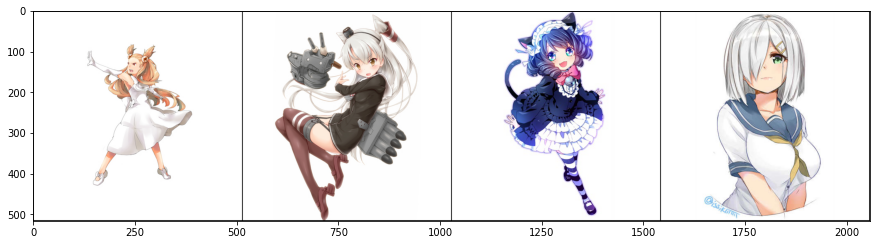

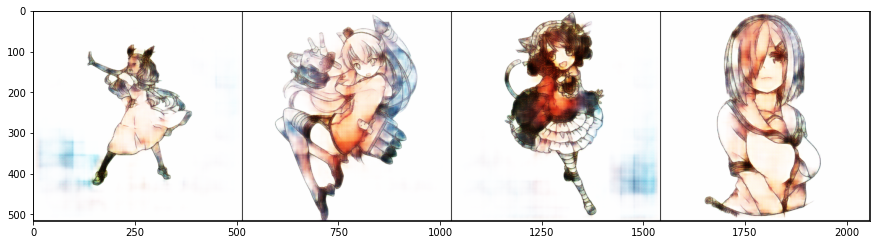


FID :  64.85327



Num epochs : 3


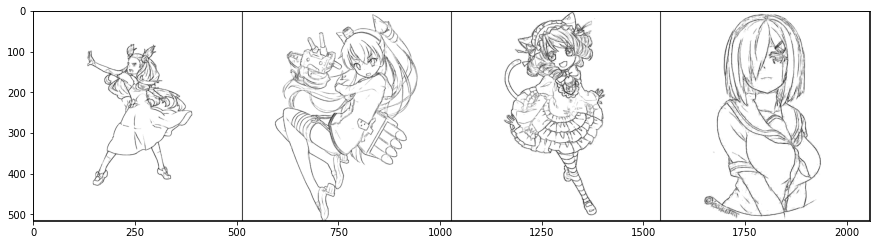

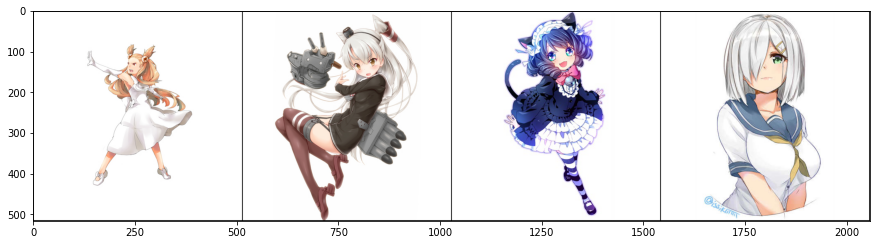

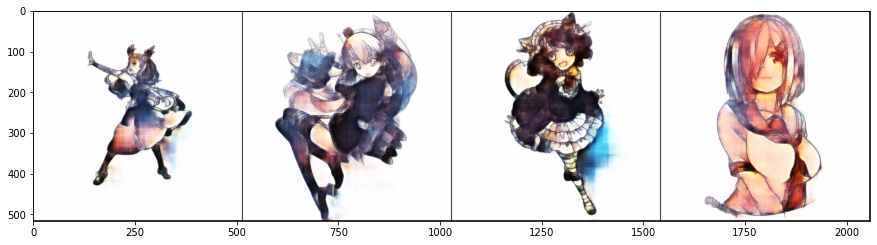


FID :  52.48233



Num epochs : 4


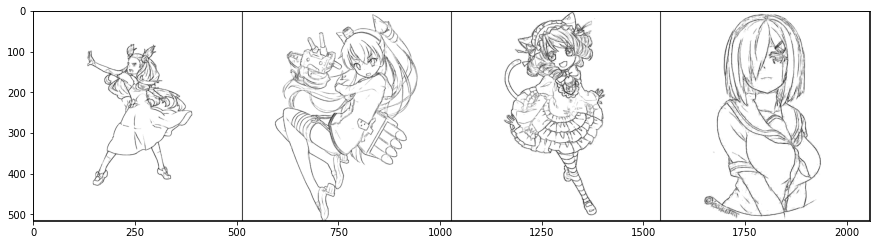

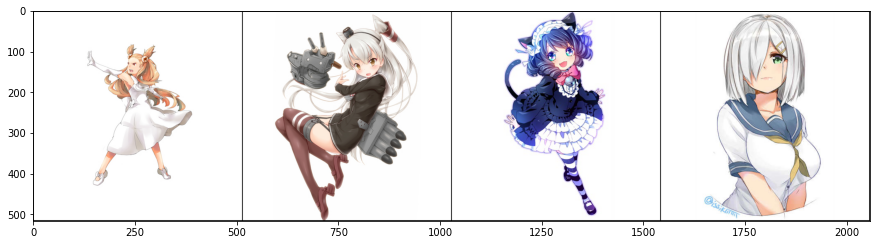

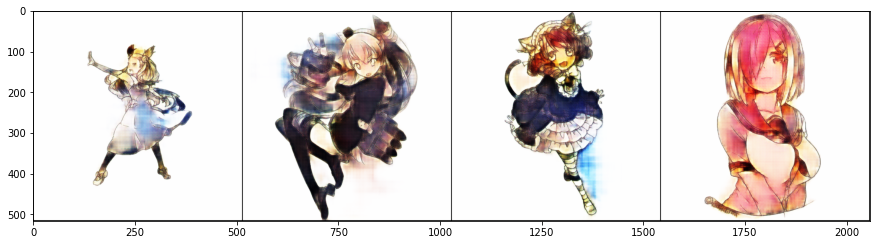


FID :  41.765625



Num epochs : 5


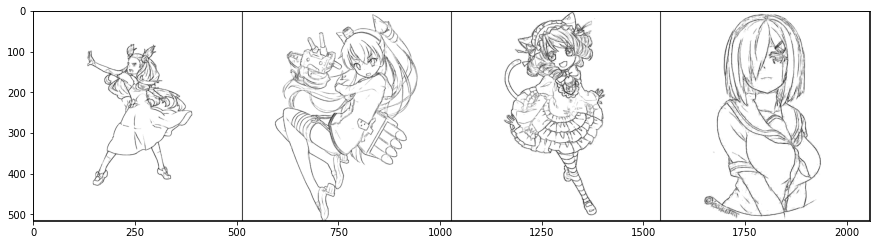

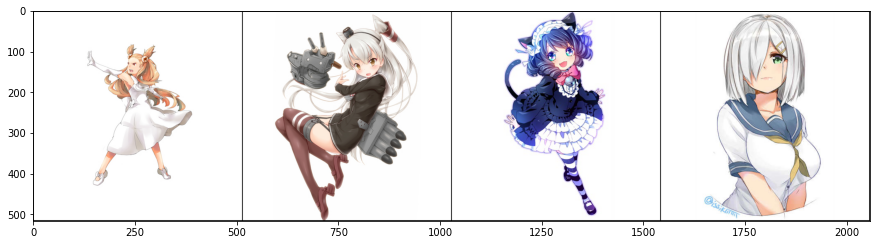

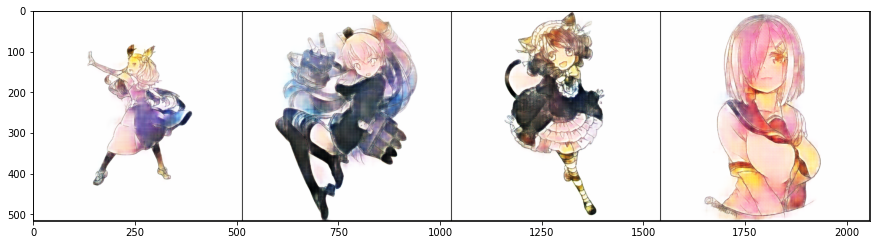


FID :  41.950134



Num epochs : 6


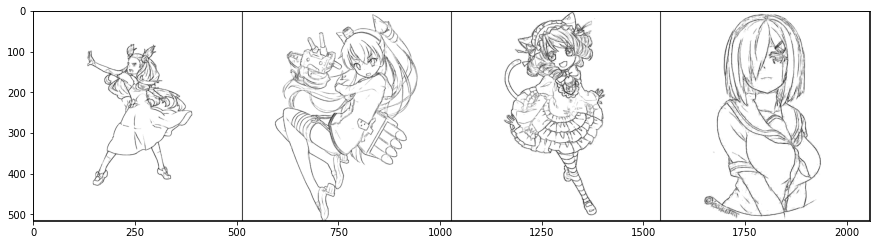

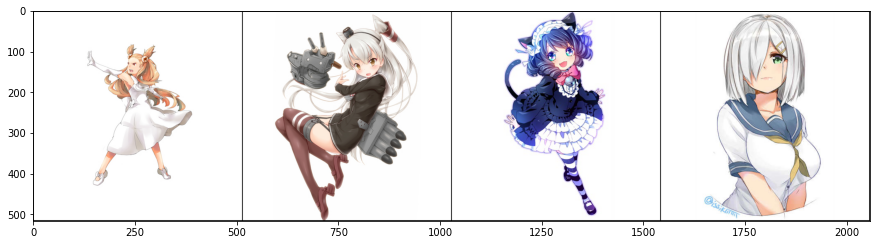

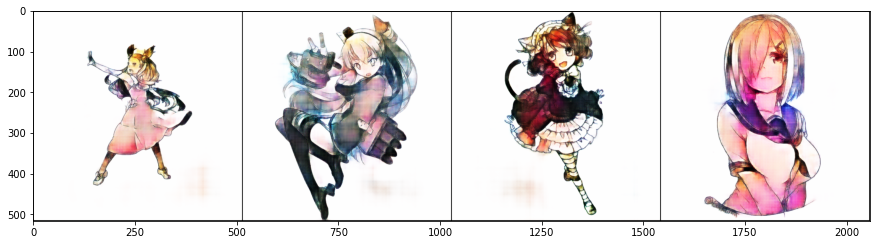


FID :  35.934814



Num epochs : 7


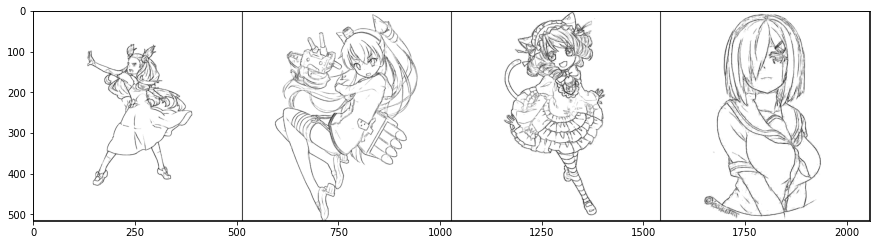

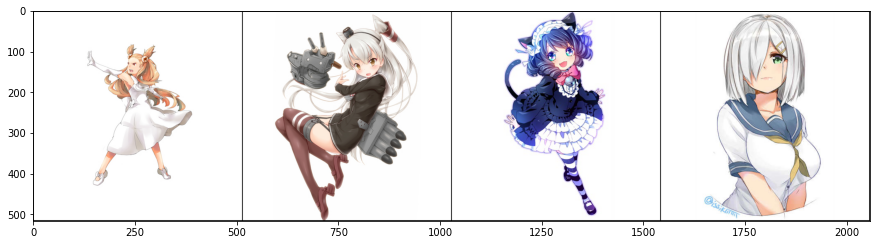

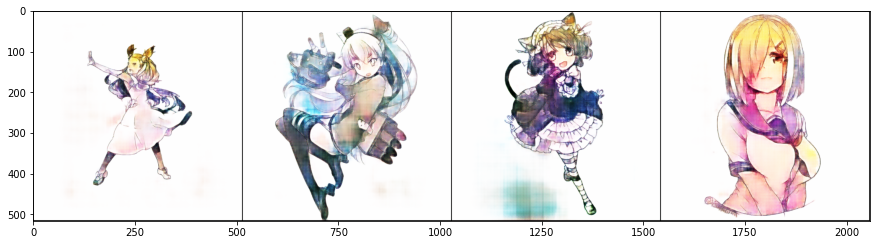


FID :  37.36145



Num epochs : 8


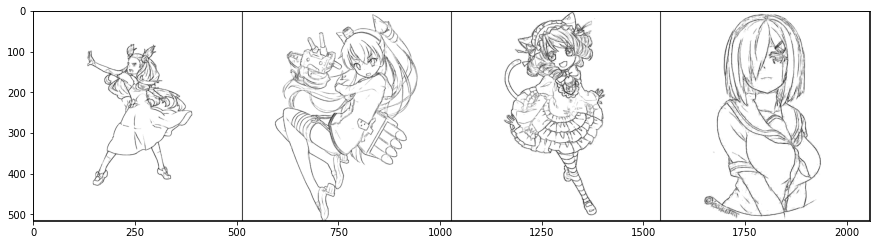

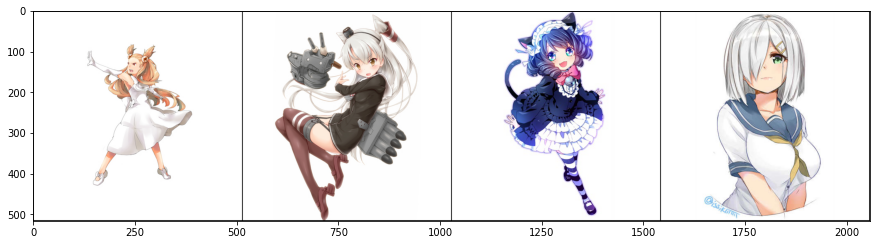

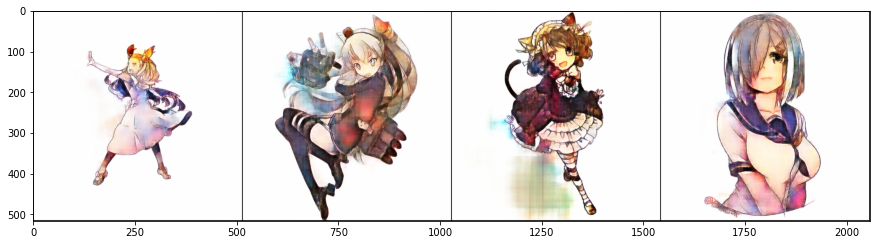


FID :  40.00937



Num epochs : 9


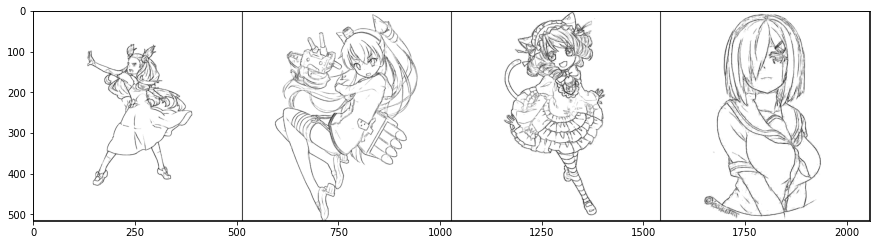

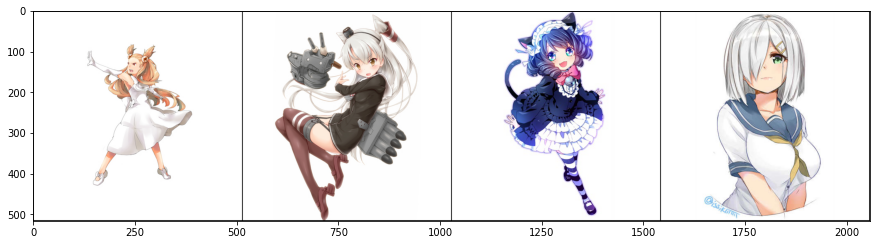

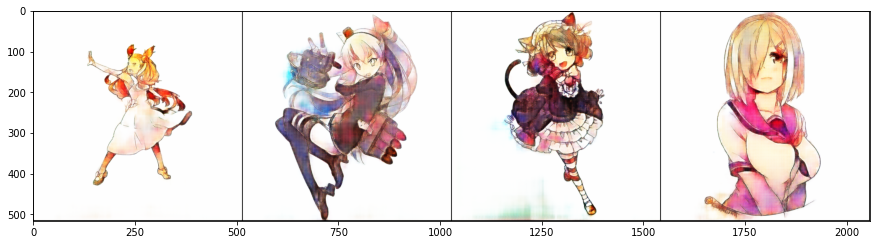


FID :  39.704376



Num epochs : 10


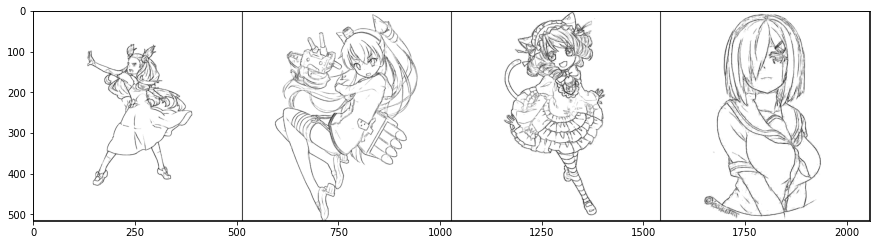

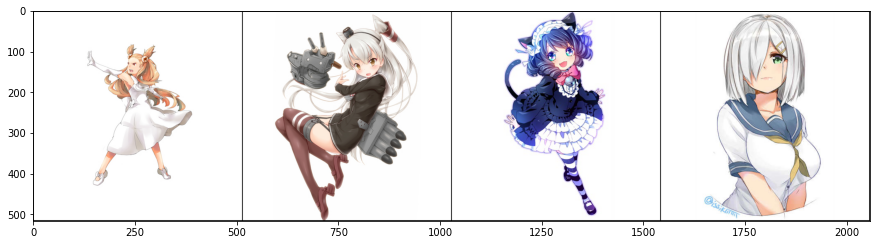

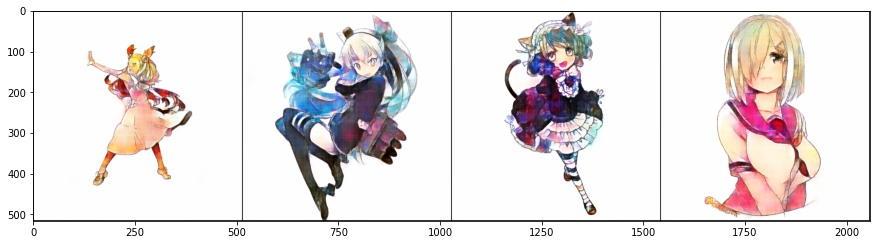


FID :  27.386902



Num epochs : 11


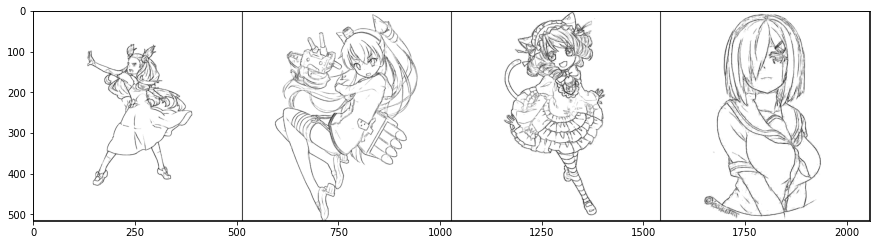

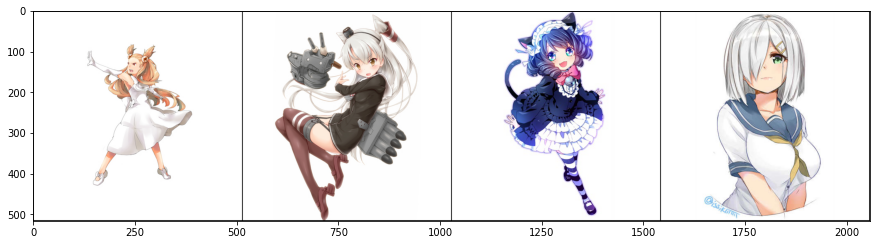

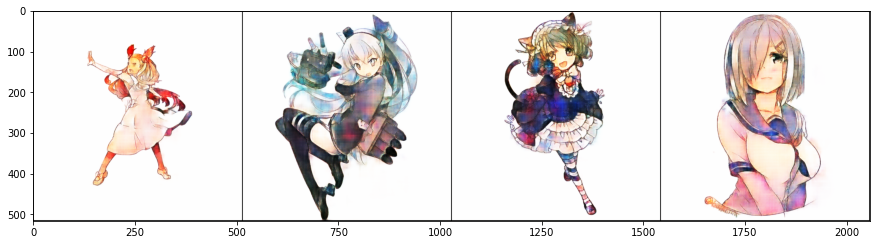


FID :  28.269653



Num epochs : 12


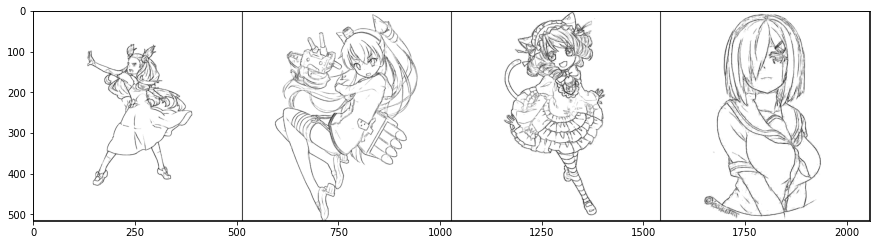

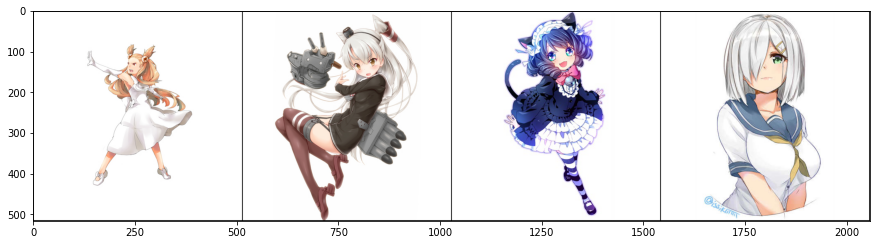

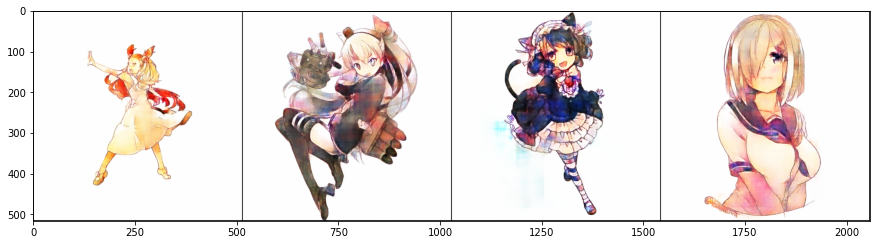


FID :  27.253113



Num epochs : 13


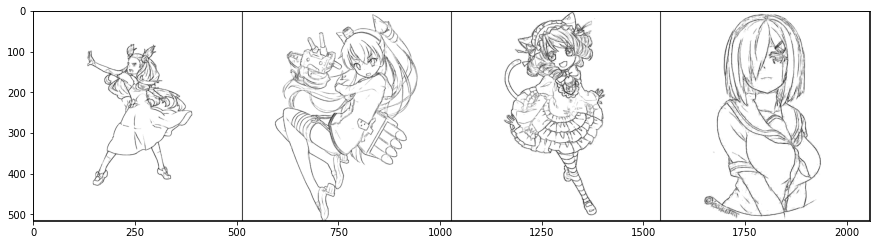

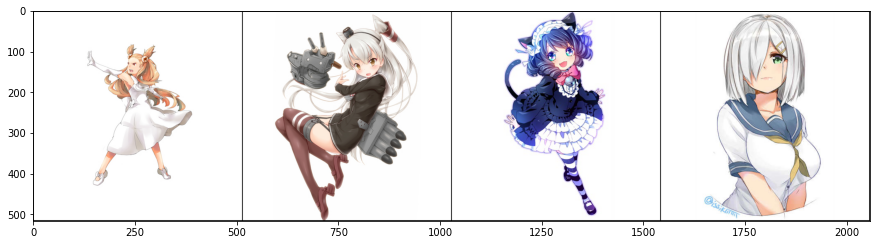

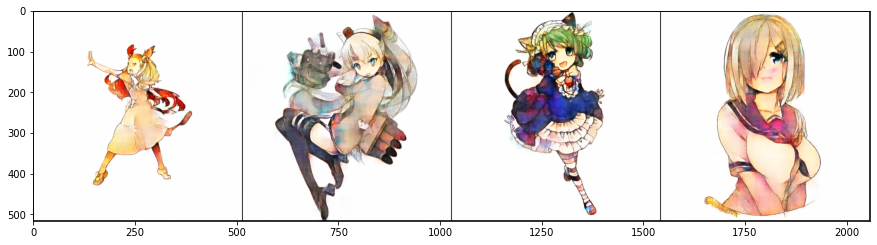


FID :  29.897064



Num epochs : 14


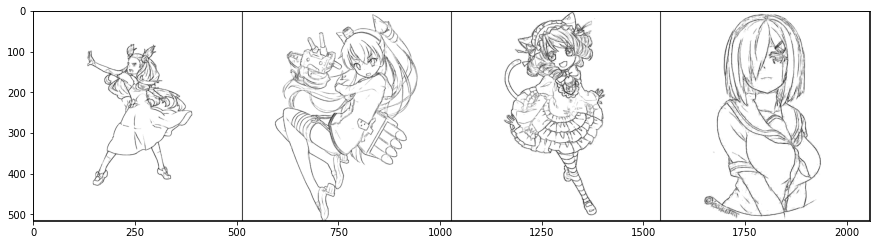

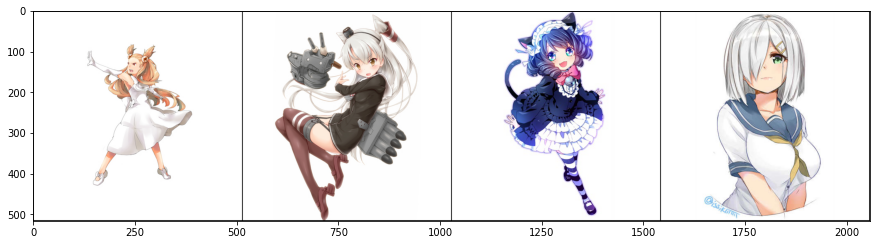

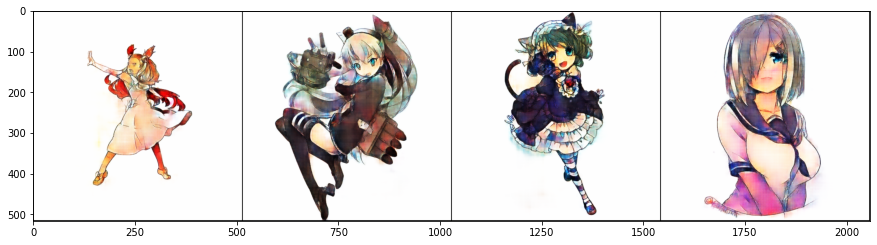


FID :  26.930145



Num epochs : 15


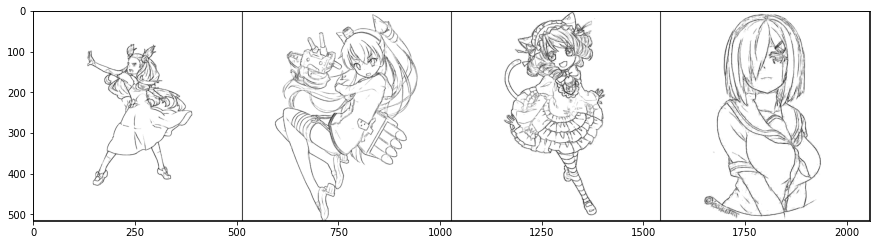

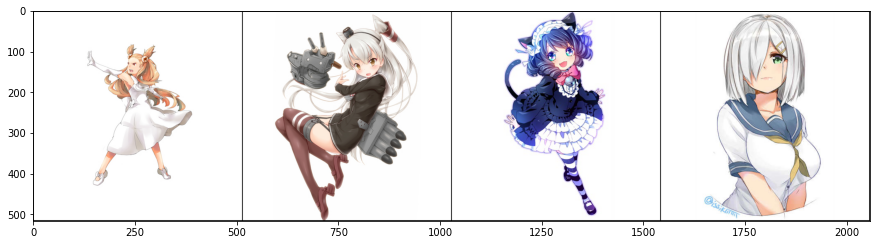

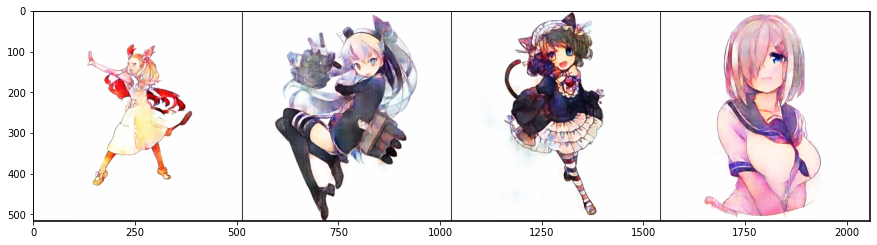


FID :  23.799316



Num epochs : 16


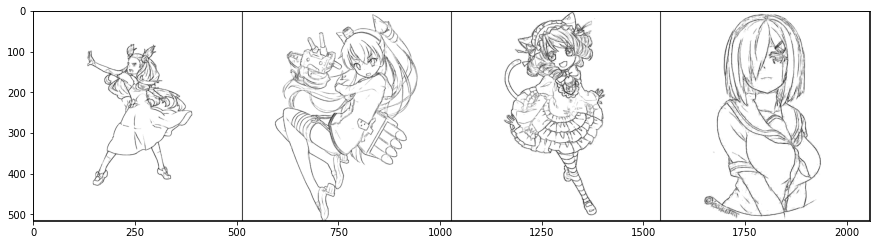

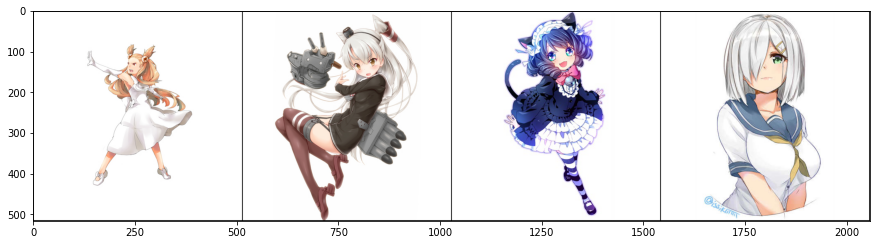

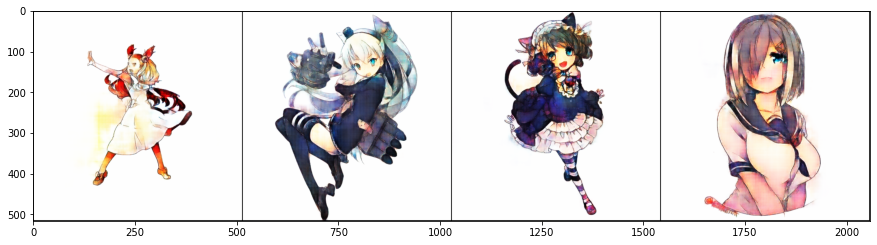


FID :  24.897858



Num epochs : 17


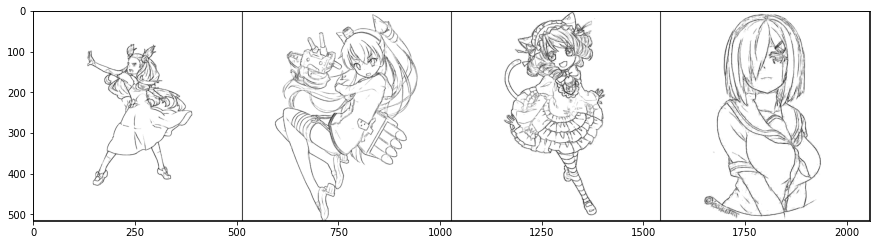

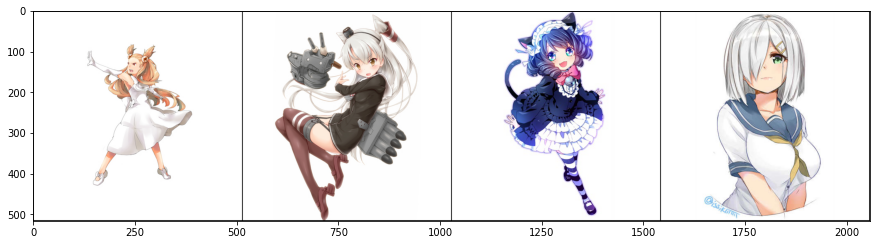

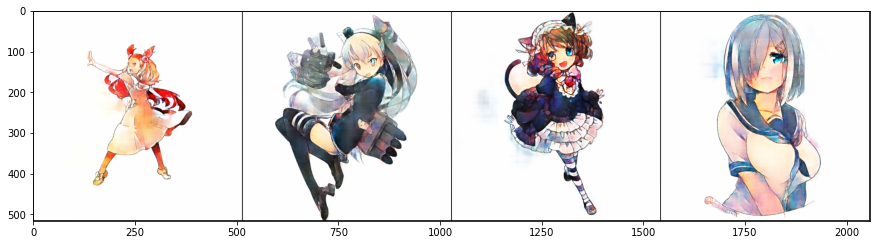


FID :  22.66336



Num epochs : 18


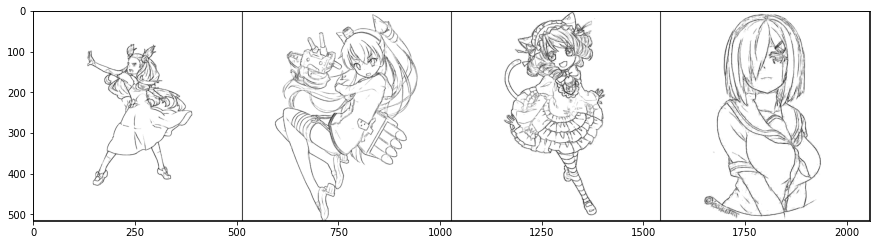

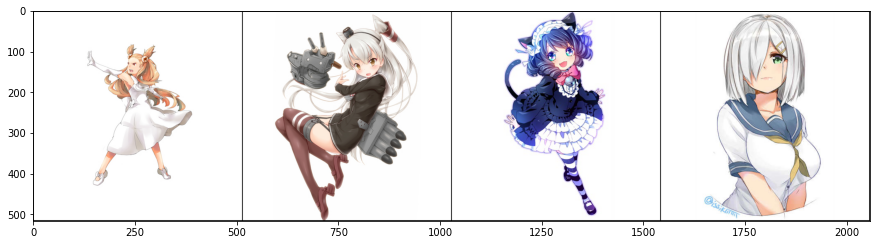

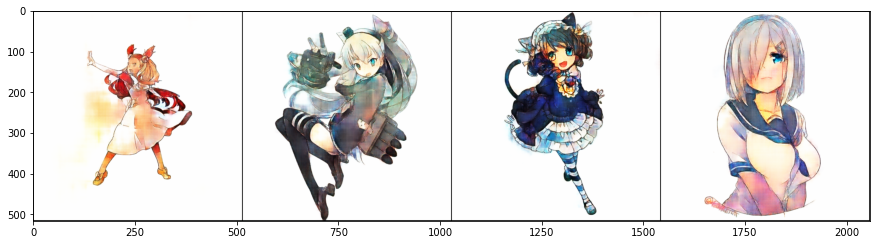


FID :  21.387024



Num epochs : 19


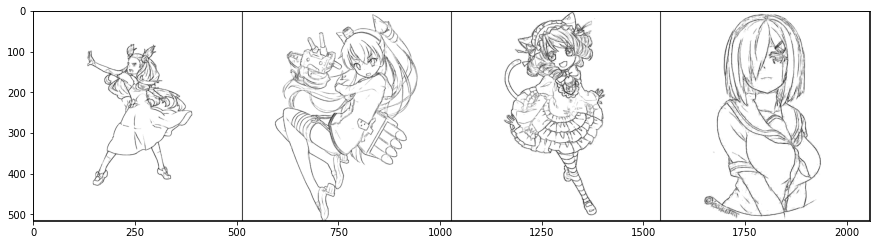

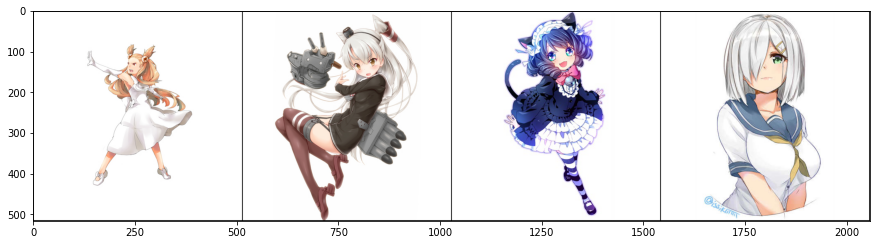

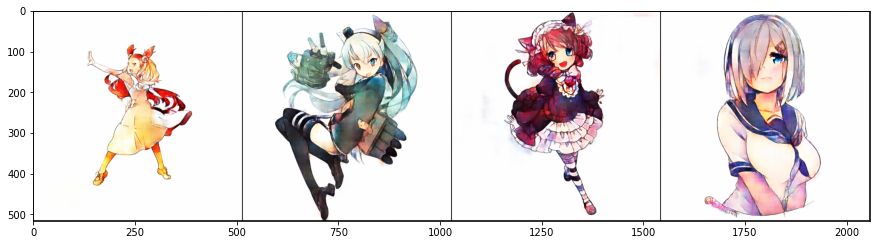


FID :  21.346344



Num epochs : 20


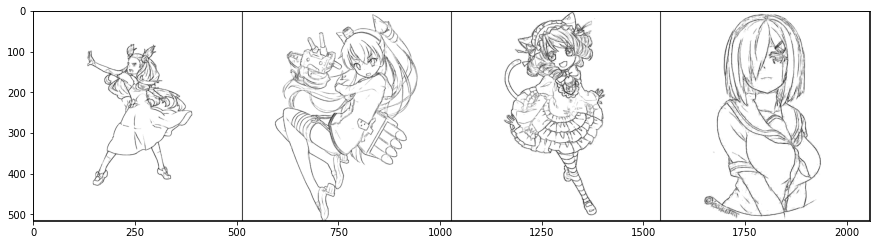

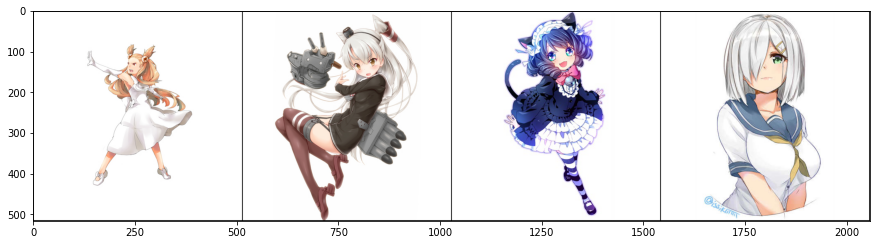

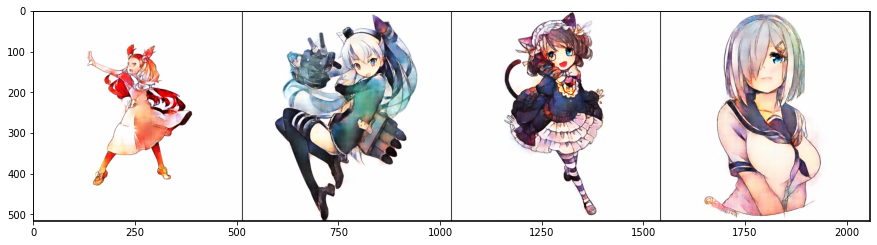


FID :  22.279846


In [ ]:
hist_g = []
hist_d = []
hist_fid = []
best_fid = np.inf
for e in range(0, 20):
  loss_generator = 0.
  loss_discriminator = 0.
  curr = 0
  t = tqdm(dataloader)
  correct_f = 0
  total_f = 0
  correct_r = 0
  total_r = 0
  for i, (conditions, reals) in enumerate(t):
    conditions = nn.functional.interpolate(conditions, resize) 
    reals = nn.functional.interpolate(reals, resize)

    #print(conditions.shape)
    conditions = conditions.to(device)
    reals = reals.to(device)

    # update discriminator
    if i % 2 == 0:
      optimizer_disc.zero_grad()

      with torch.no_grad():
        # generate fake image 
        fakes = gen(conditions)
      preds_fakes = disc( create_inputs_disc(fakes, conditions) )
      preds_reals = disc( create_inputs_disc(reals, conditions) )
      loss_disc = get_disc_loss(preds_reals, preds_fakes)
      loss_disc.backward()
      optimizer_disc.step()
      loss_discriminator += loss_disc.item()
      ## acc
      correct_f += (torch.round(preds_fakes).cpu().detach().numpy() == 0).sum() 
      correct_r += (torch.round(preds_reals).cpu().detach().numpy() == 1).sum()
      total_f += len(preds_fakes) 
      total_r += len(preds_reals)
      curr += 1

    # update generator
    optimizer_gen.zero_grad()

    # generate fake image 
    fakes = gen(conditions)

    preds_fakes = disc( create_inputs_disc(fakes, conditions) ) 
    loss_gen = get_gen_loss(preds_fakes, alpha, fakes, reals) + features_loss(fakes, reals, vgg, alpha=alpha_features) + total_variation_loss(fakes, alpha=alpha_variation)
    #print(torch.isnan(preds_fakes).sum(), torch.isnan(fakes).sum(), features_loss(fakes, reals, vgg, alpha=alpha_features) ,  total_variation_loss(fakes, alpha=alpha_variation))
    loss_gen.backward()
    optimizer_gen.step()

    
    loss_generator += loss_gen.item()
    

    t.set_description("Loss : {0} / {1} | acc disc f/r: {2}/{3}".format(round(loss_generator/(i+1),4), round(loss_discriminator/curr, 4),
                                                                 round(correct_f/total_f, 3 ) , round(correct_r/total_r, 3 )))
    t.refresh()      
  loss_generator /= curr
  loss_discriminator /= curr
  
  hist_g.append(loss_generator)
  hist_d.append(loss_discriminator)

  # show image
  print("Num epochs : {0}".format(e+1))
  # im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
  # im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
  # im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255
  # im_v = cv2.vconcat([im1.astype(np.uint8), im2.astype(np.uint8), im3.astype(np.uint8)])
  try: 
    os.makedirs("drive/MyDrive/GAN_{0}".format(resize))
  except:
    pass
  # cv2.imwrite("drive/MyDrive/GAN_{0}/image_{1}.jpg".format(resize, e), im_v[:, :, ::-1])
  # torch.save(gen.state_dict(), "drive/MyDrive/pix2pixgen512.pth")
  # torch.save(disc.state_dict(), "drive/MyDrive/pix2pixdisc512.pth")
  if e%evaluation_every_e == 0 and e >= 0:
    conditions, reals, fakes = inference(gen, val_dataset, ids=[0,260,310,477], device=device)
    im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
    im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
    im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255
    im_v = cv2.vconcat([im1.astype(np.uint8), im2.astype(np.uint8), im3.astype(np.uint8)])
    cv2.imwrite("drive/MyDrive/GAN_{0}/val_image_{1}.jpg".format(resize, e), im_v[:, :, ::-1])
    val_results = evaluate(gen, val_dataloader, fid)
    hist_fid.append(val_results)
    print("FID : ", val_results)
    if val_results < best_fid :
      best_fid = val_results
      torch.save(gen.state_dict(), "drive/MyDrive/pix2pixgen512.pth")
      torch.save(disc.state_dict(), "drive/MyDrive/pix2pixdisc512.pth")


Num epochs : 21


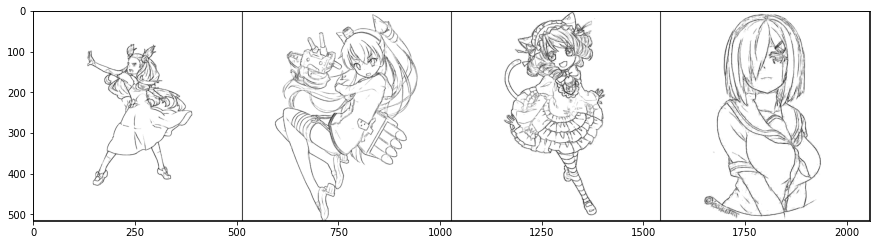

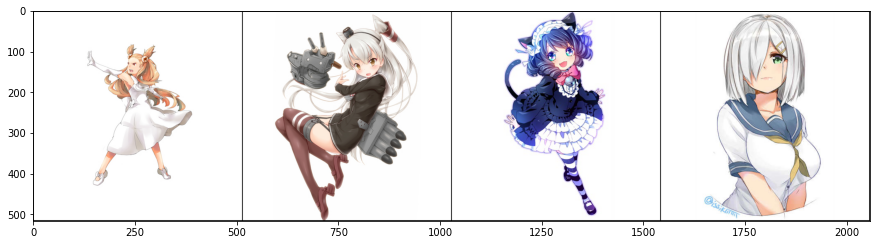

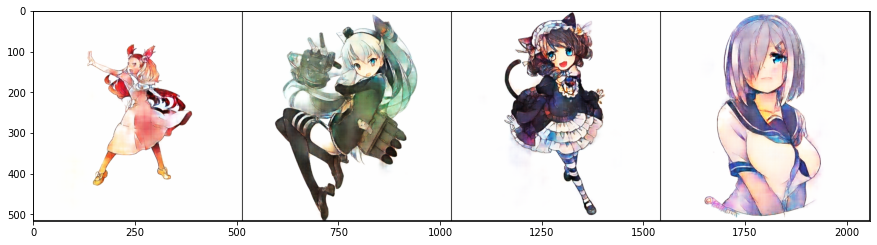


FID :  21.515442



Num epochs : 22


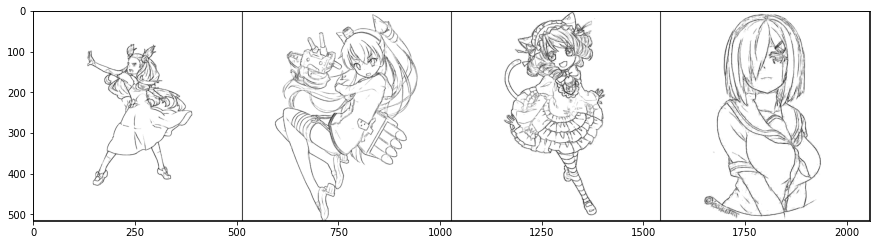

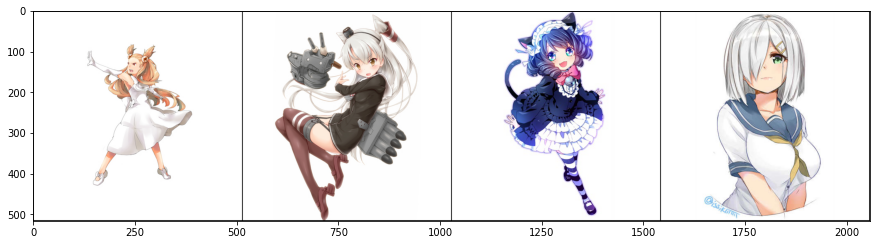

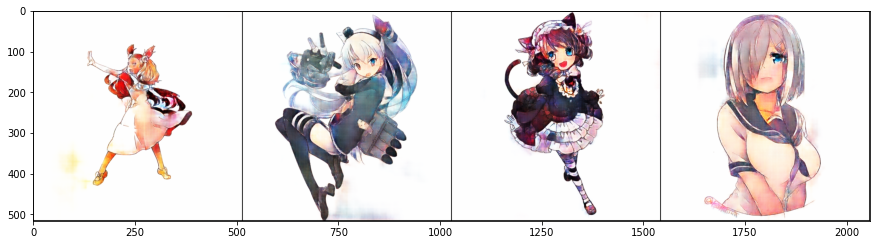


FID :  22.263031



Num epochs : 23


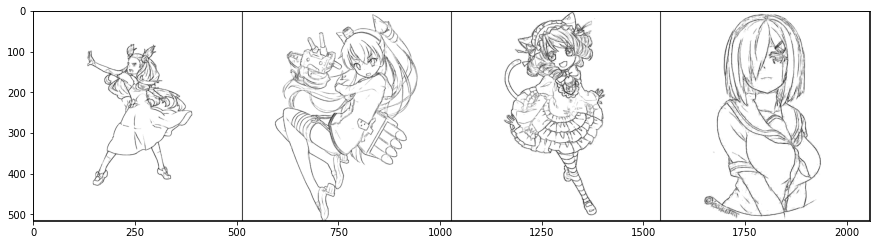

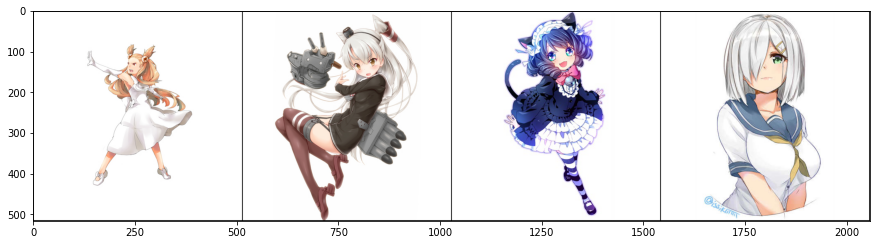

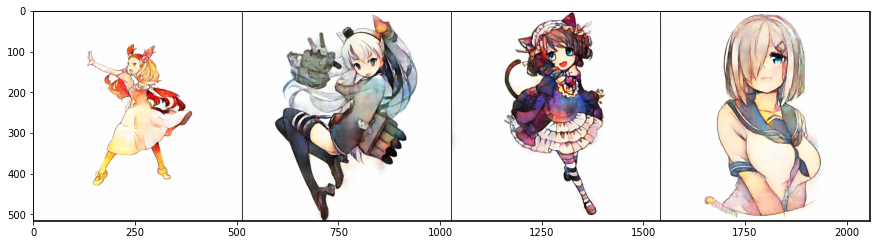


FID :  27.977875



Num epochs : 24


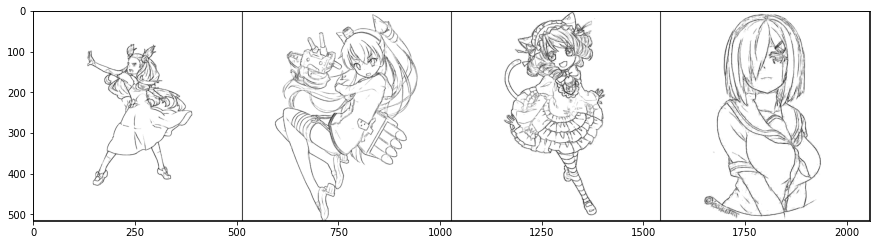

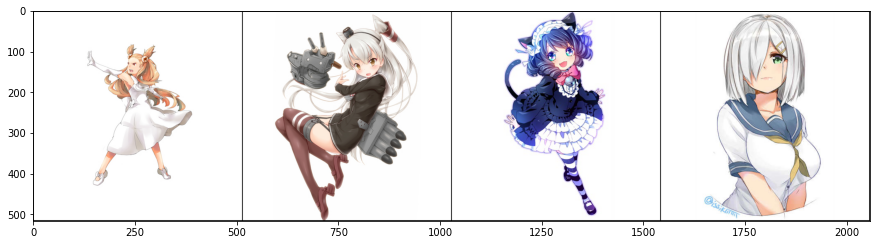

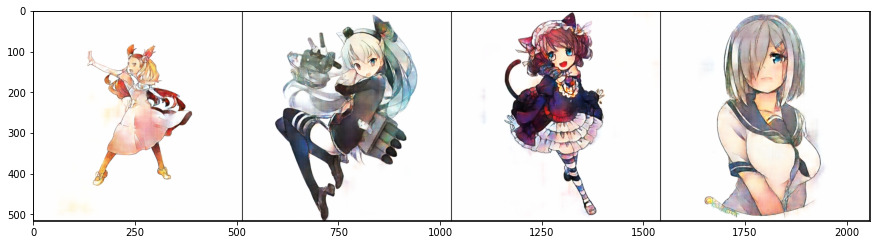


FID :  20.331726



Num epochs : 25


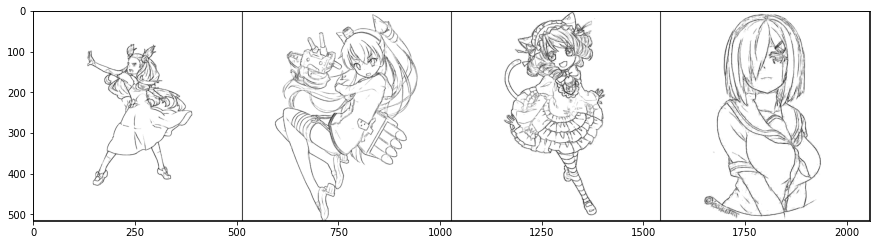

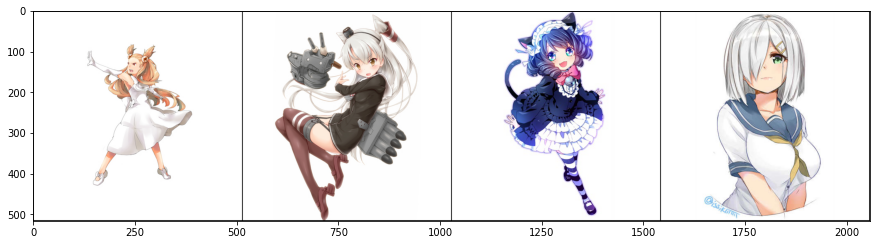

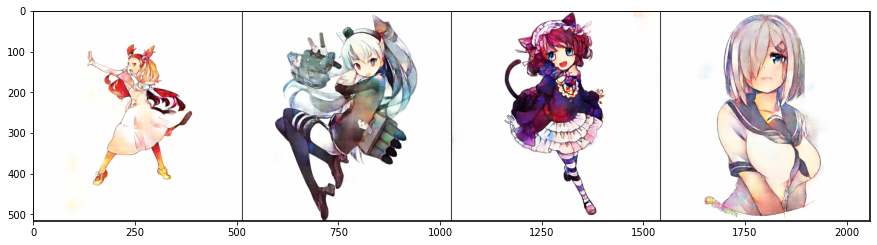


FID :  20.188263



Num epochs : 26


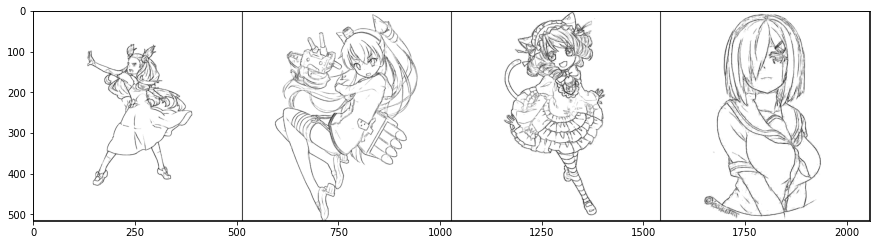

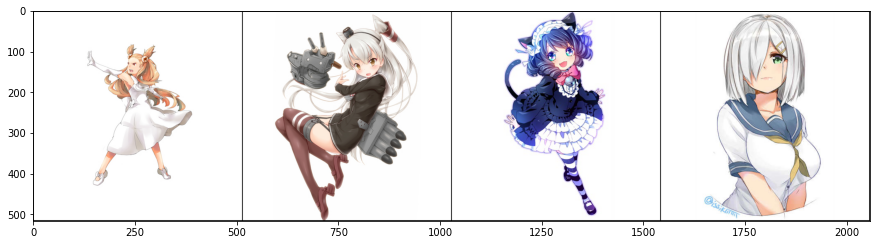

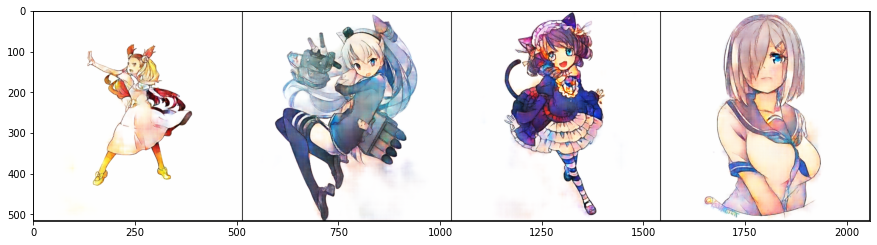


FID :  26.487274



Num epochs : 27


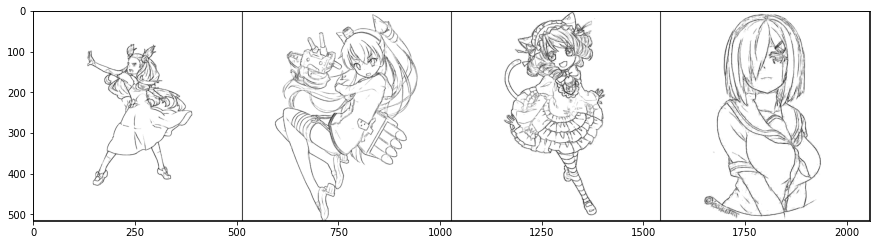

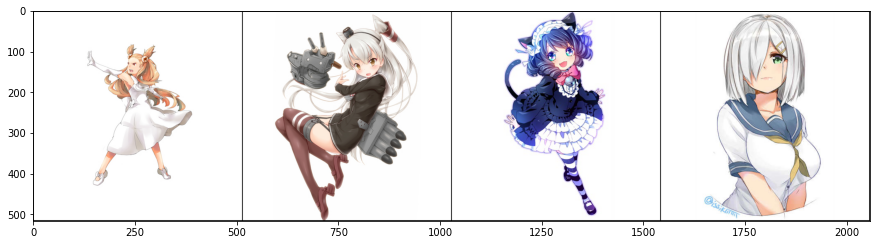

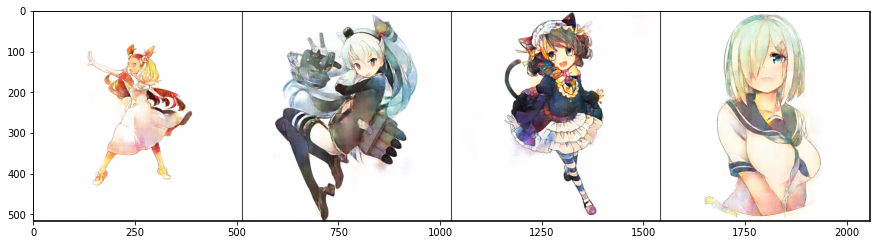


FID :  22.516235



Num epochs : 28


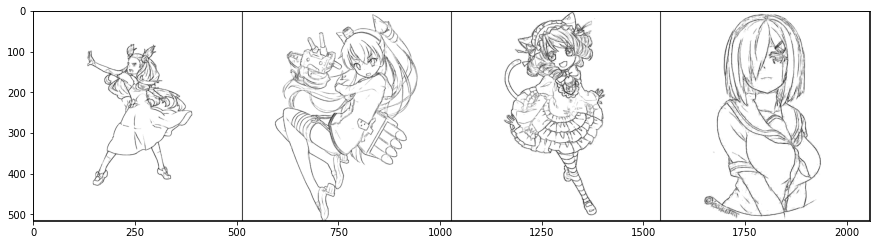

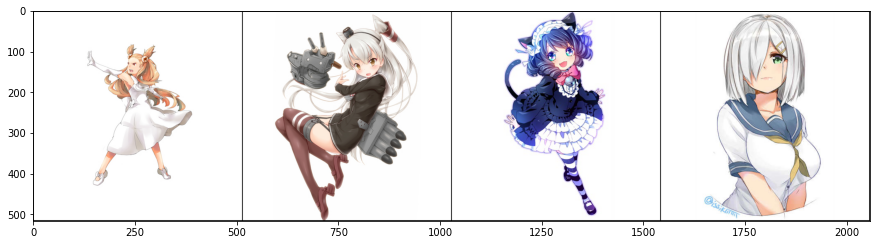

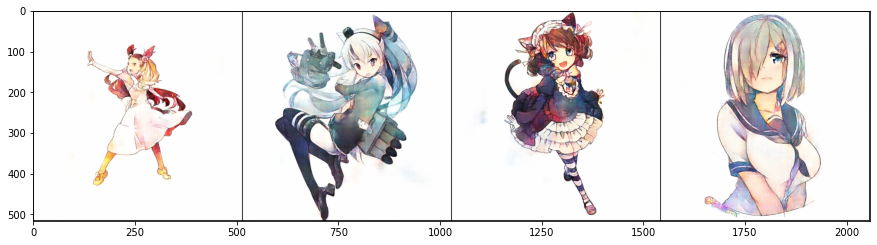


FID :  18.680878



Num epochs : 29


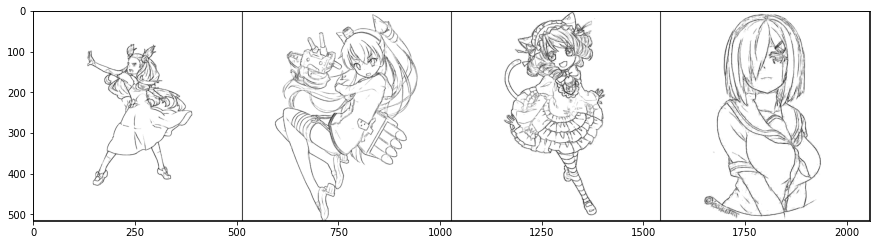

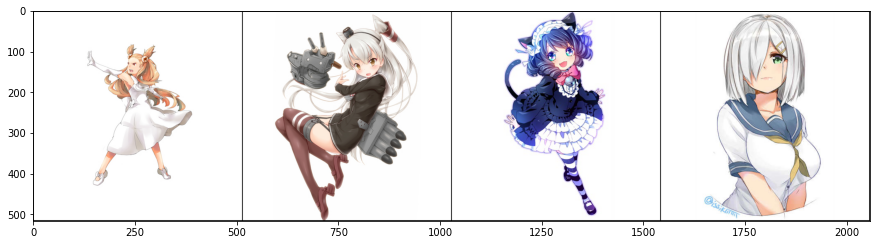

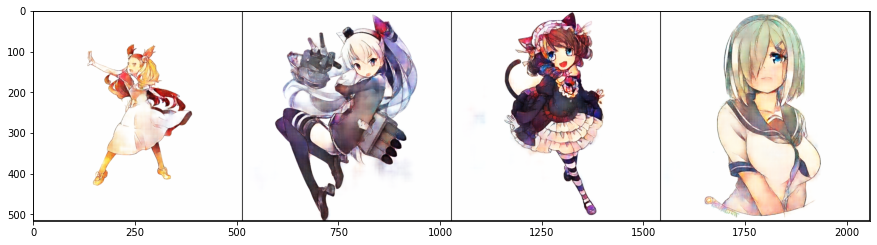


FID :  19.223999



Num epochs : 30


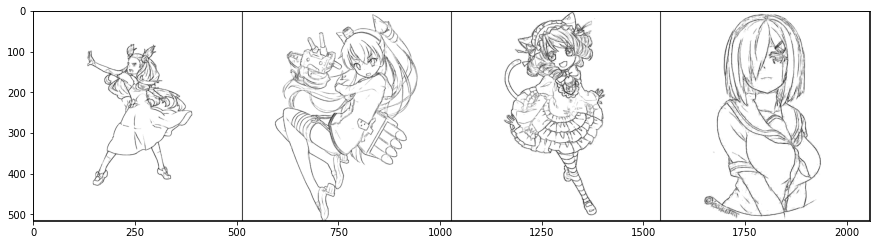

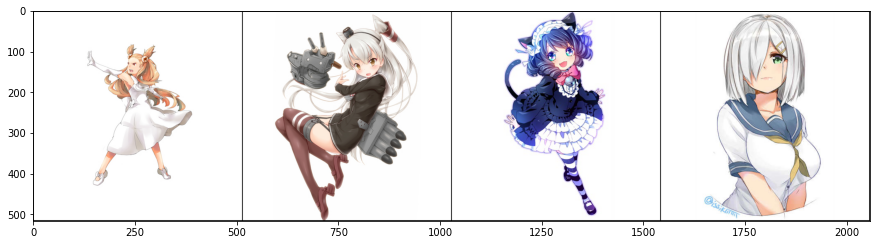

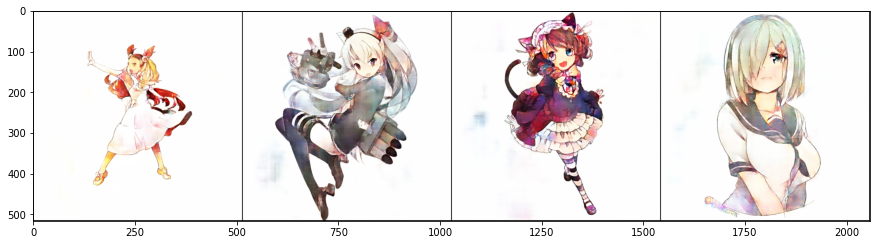


FID :  21.697723



Num epochs : 31


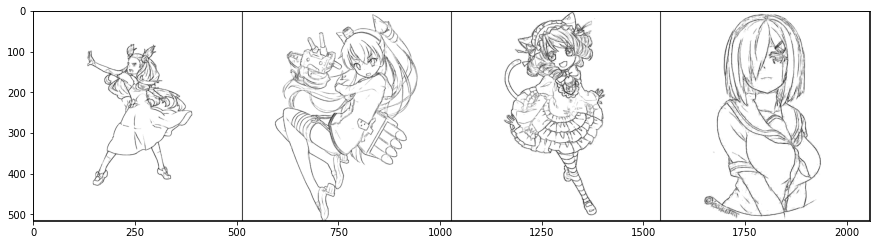

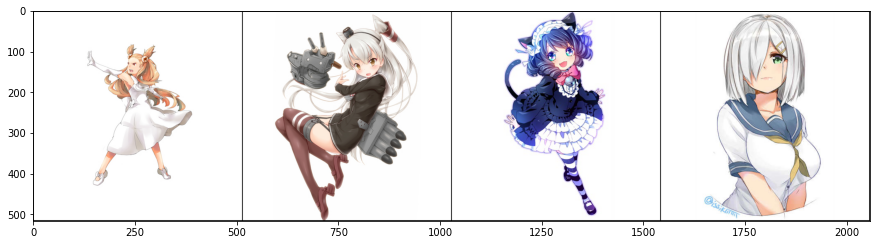

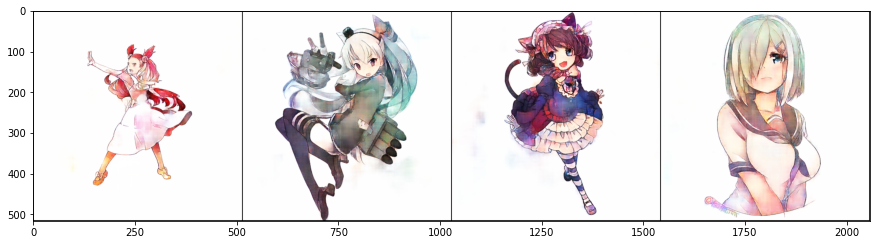


FID :  19.432678



Num epochs : 32


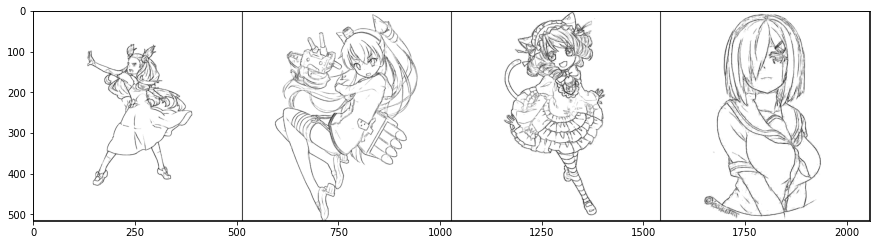

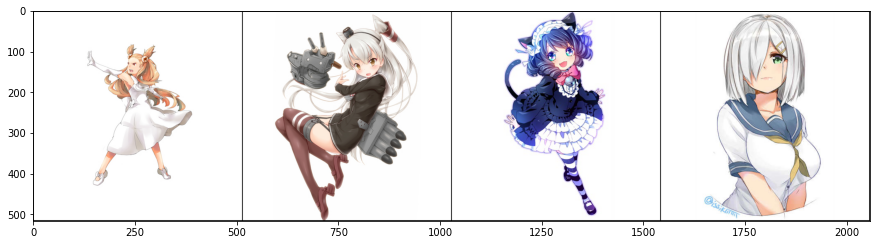

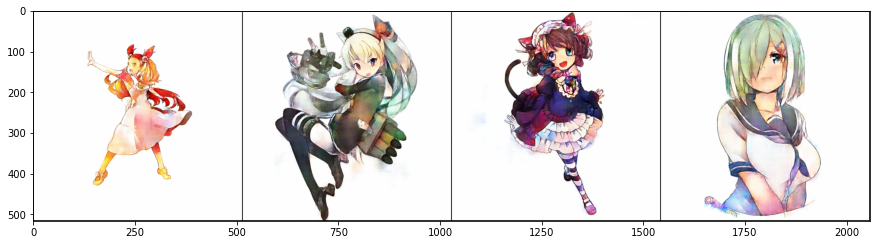


FID :  18.87024



Num epochs : 33


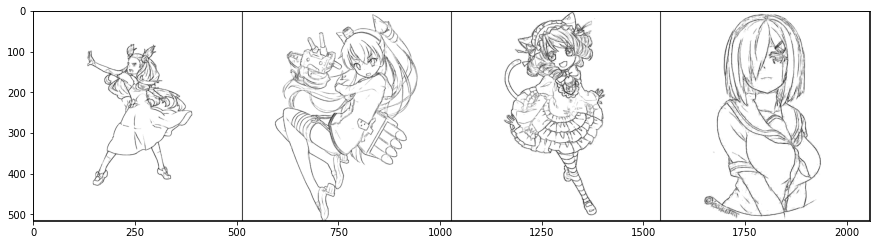

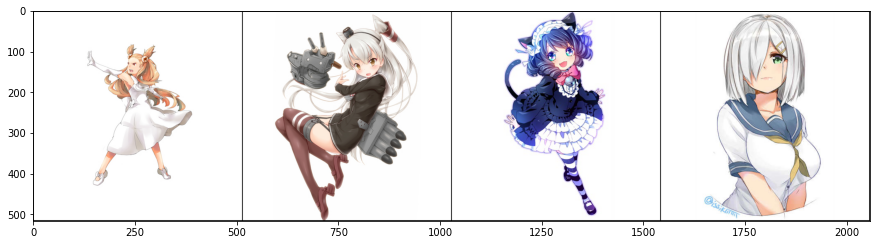

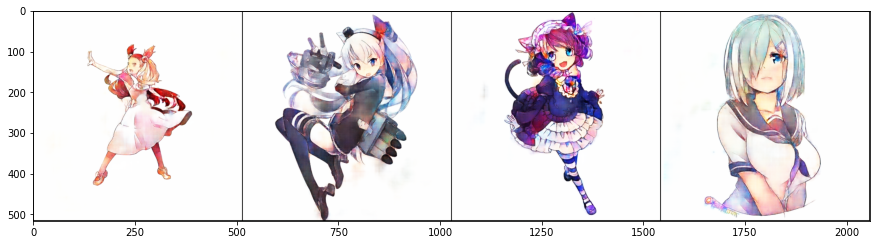


FID :  18.017975



Num epochs : 34


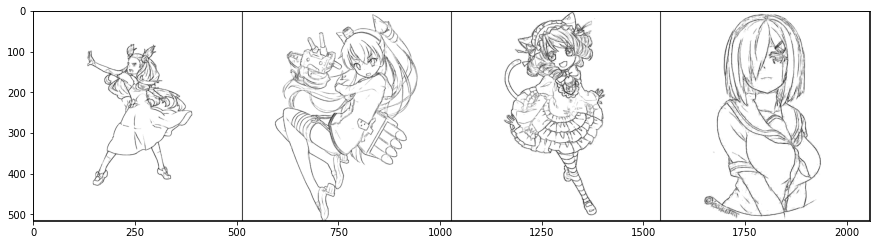

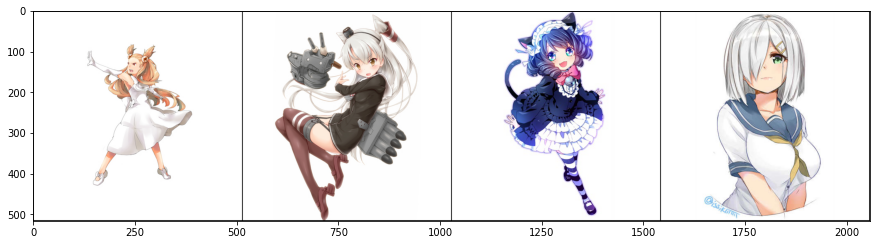

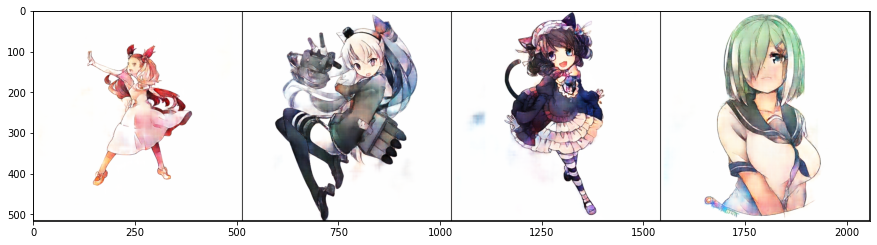


FID :  20.730682



Num epochs : 35


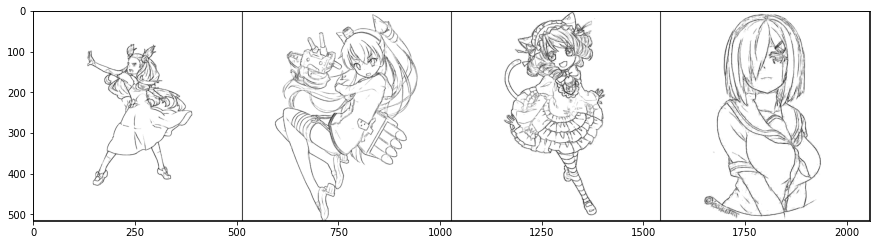

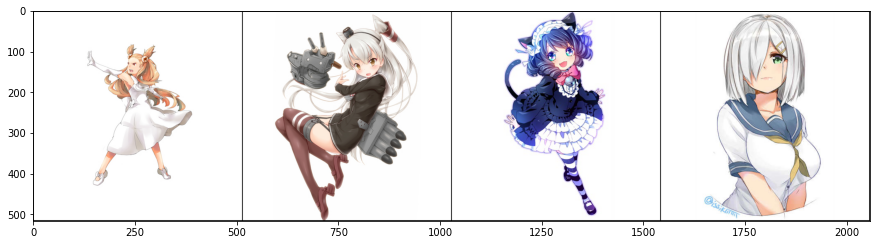

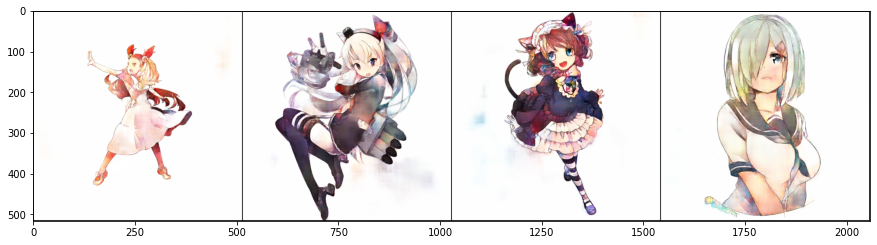


FID :  19.703125



Num epochs : 36


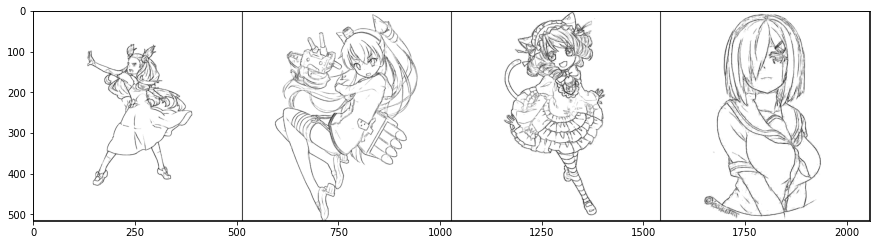

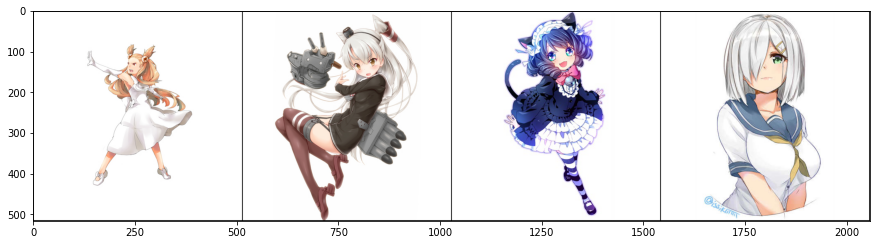

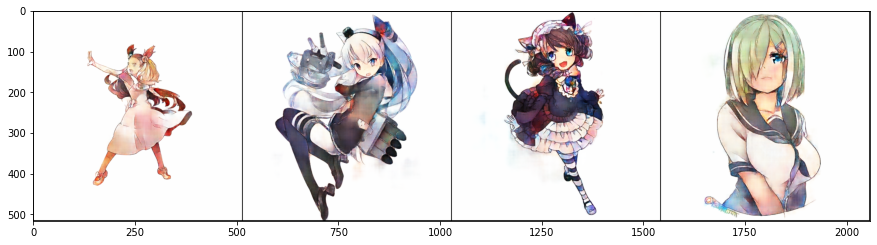


FID :  18.80606



Num epochs : 37


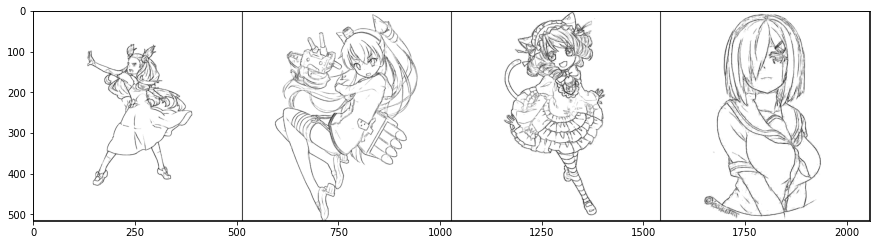

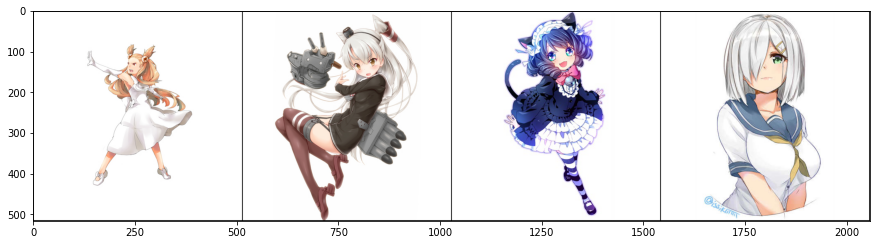

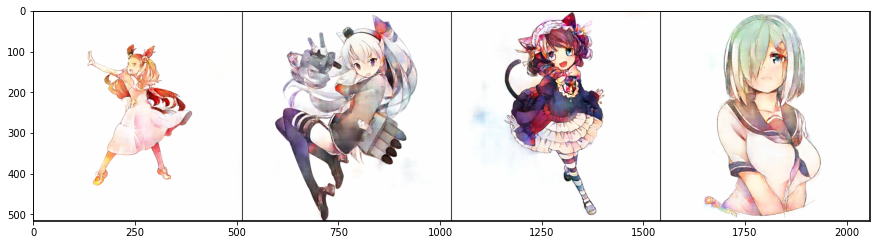


FID :  20.980835



Num epochs : 38


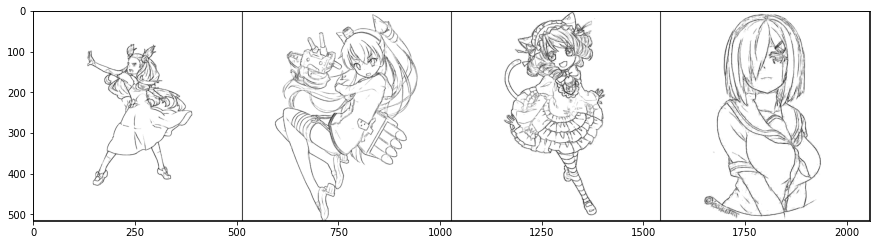

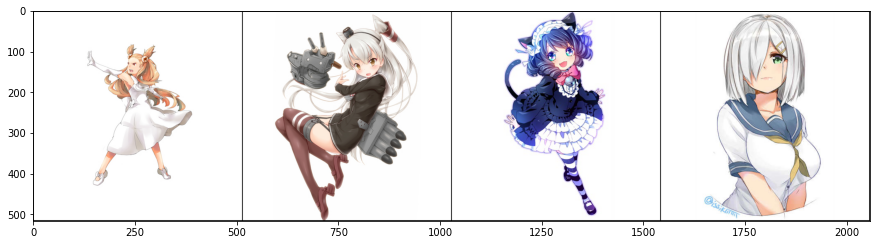

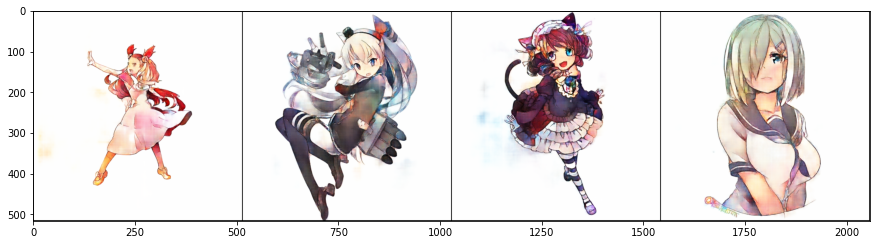


FID :  18.229218



Num epochs : 39


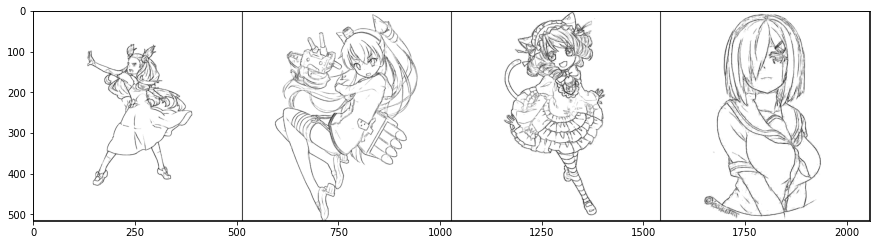

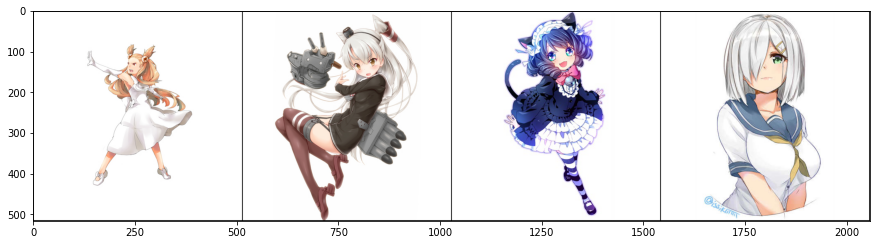

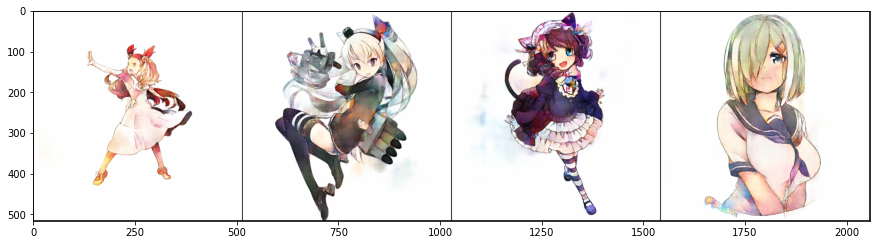


FID :  18.588318



Num epochs : 40


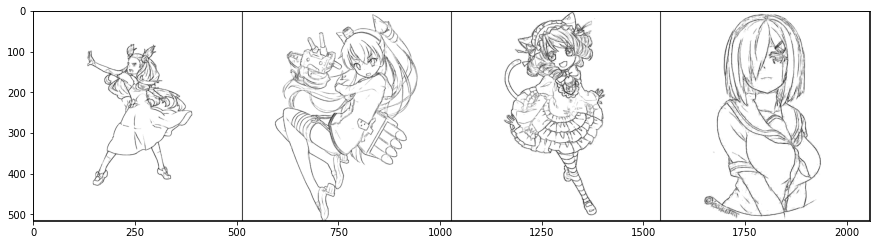

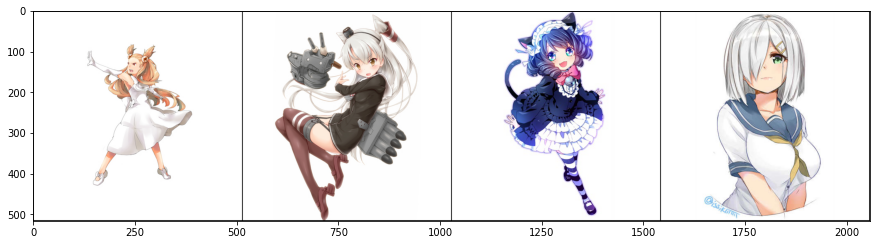

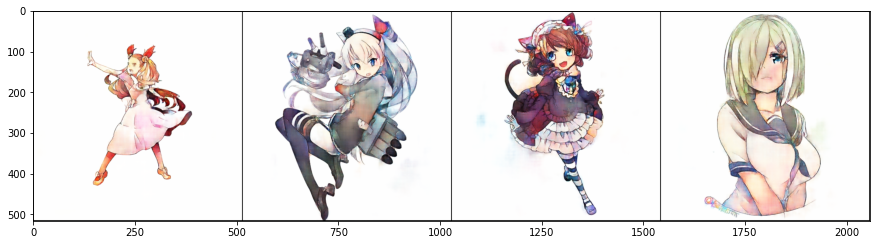


FID :  22.281097


In [ ]:
best_fid = np.inf

for e in range(20, 40):
  loss_generator = 0.
  loss_discriminator = 0.
  curr = 0
  t = tqdm(dataloader)
  correct_f = 0
  total_f = 0
  correct_r = 0
  total_r = 0
  for i, (conditions, reals) in enumerate(t):
    conditions = nn.functional.interpolate(conditions, resize) 
    reals = nn.functional.interpolate(reals, resize)

    #print(conditions.shape)
    conditions = conditions.to(device)
    reals = reals.to(device)
    

    

    # update discriminator
    if i % 2 == 0:
      optimizer_disc.zero_grad()

      with torch.no_grad():
        # generate fake image 
        fakes = gen(conditions)
      preds_fakes = disc( create_inputs_disc(fakes, conditions) )
      preds_reals = disc( create_inputs_disc(reals, conditions) )
      loss_disc = get_disc_loss(preds_reals, preds_fakes)
      loss_disc.backward()
      optimizer_disc.step()
      loss_discriminator += loss_disc.item()
      ## acc
      correct_f += (torch.round(preds_fakes).cpu().detach().numpy() == 0).sum() 
      correct_r += (torch.round(preds_reals).cpu().detach().numpy() == 1).sum()
      total_f += len(preds_fakes) 
      total_r += len(preds_reals)
      curr += 1

    # update generator
    optimizer_gen.zero_grad()

    # generate fake image 
    fakes = gen(conditions)

    preds_fakes = disc( create_inputs_disc(fakes, conditions) ) 
    loss_gen = get_gen_loss(preds_fakes, alpha, fakes, reals) + features_loss(fakes, reals, vgg, alpha=alpha_features) + total_variation_loss(fakes, alpha=alpha_variation)
    #print(torch.isnan(preds_fakes).sum(), torch.isnan(fakes).sum(), features_loss(fakes, reals, vgg, alpha=alpha_features) ,  total_variation_loss(fakes, alpha=alpha_variation))
    loss_gen.backward()
    optimizer_gen.step()

    
    loss_generator += loss_gen.item()
    

    t.set_description("Loss : {0} / {1} | acc disc f/r: {2}/{3}".format(round(loss_generator/(i+1),4), round(loss_discriminator/curr, 4),
                                                                 round(correct_f/total_f, 3 ) , round(correct_r/total_r, 3 )))
    t.refresh()      
  loss_generator /= curr
  loss_discriminator /= curr
  
  hist_g.append(loss_generator)
  hist_d.append(loss_discriminator)

  # show image
  print("Num epochs : {0}".format(e+1))
  # im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
  # im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
  # im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255
  # im_v = cv2.vconcat([im1.astype(np.uint8), im2.astype(np.uint8), im3.astype(np.uint8)])
  try: 
    os.makedirs("drive/MyDrive/GAN_{0}".format(resize))
  except:
    pass
  # cv2.imwrite("drive/MyDrive/GAN_{0}/image_{1}.jpg".format(resize, e), im_v[:, :, ::-1])
  # torch.save(gen.state_dict(), "drive/MyDrive/pix2pixgen512_2.pth")
  # torch.save(disc.state_dict(), "drive/MyDrive/pix2pixdisc512_2.pth")
  if e%evaluation_every_e == 0 and e >= 0:
    conditions, reals, fakes = inference(gen, val_dataset, ids=[0,260,310,477], device=device)
    im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
    im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
    im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255
    im_v = cv2.vconcat([im1.astype(np.uint8), im2.astype(np.uint8), im3.astype(np.uint8)])
    cv2.imwrite("drive/MyDrive/GAN_{0}/val_image_{1}.jpg".format(resize, e), im_v[:, :, ::-1])
    val_results = evaluate(gen, val_dataloader, fid)
    hist_fid.append(val_results)
    print("FID : ", val_results)
    if val_results < best_fid :
      best_fid = val_results
      torch.save(gen.state_dict(), "drive/MyDrive/pix2pixgen512_3.pth")
      torch.save(disc.state_dict(), "drive/MyDrive/pix2pixdisc512_3.pth")

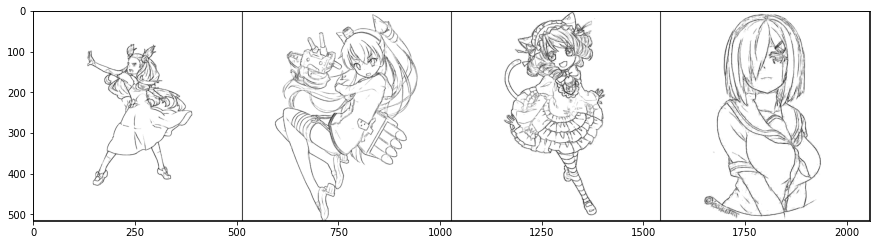

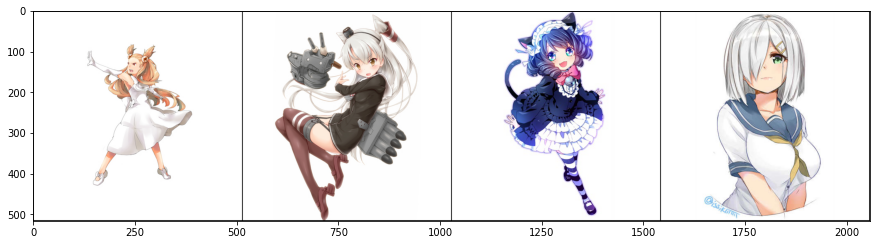

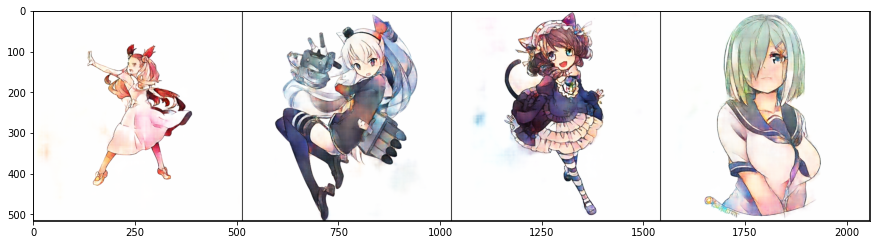


FID :  19.222992


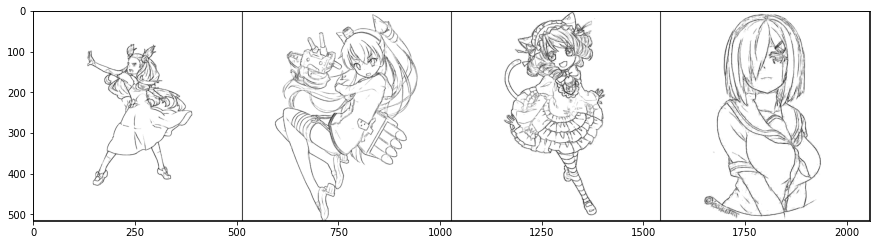

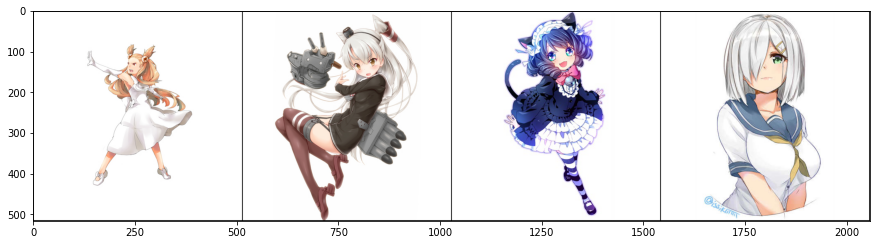

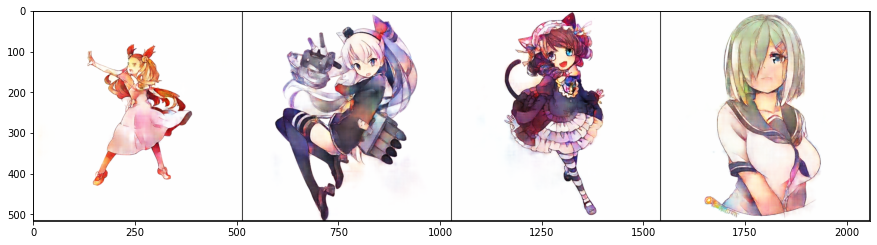


FID :  20.185455


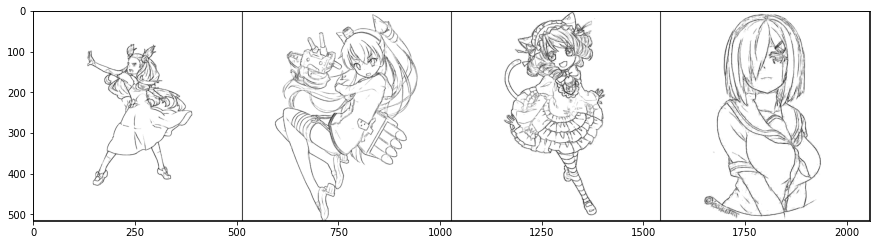

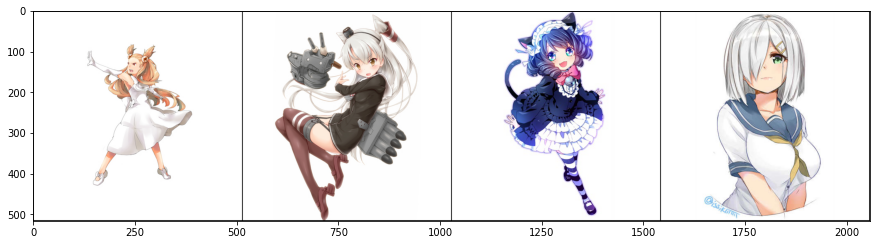

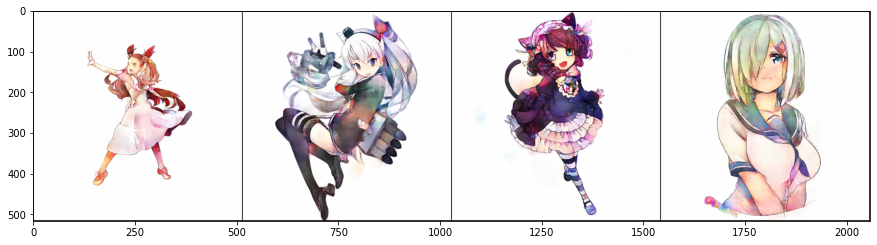


FID :  19.213165


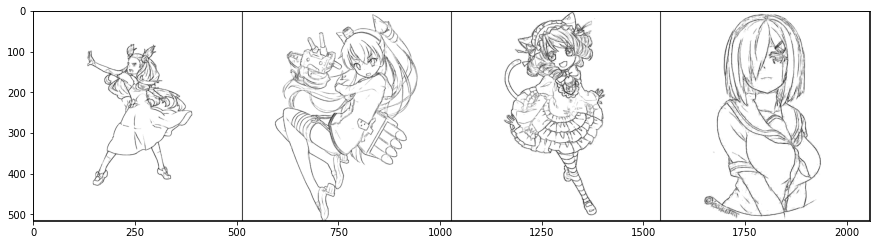

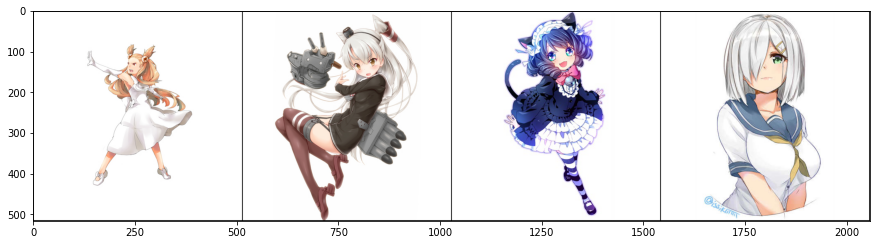

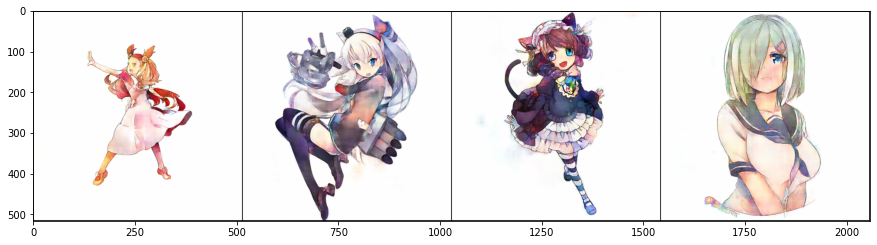


FID :  19.958038


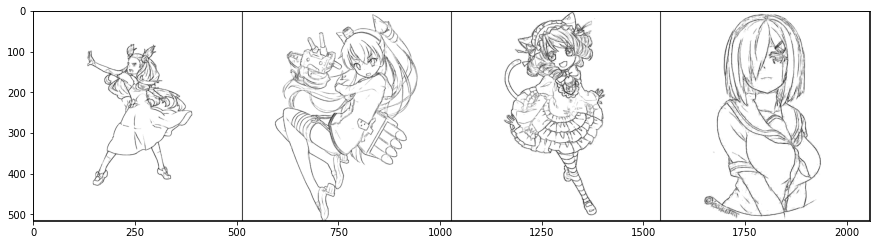

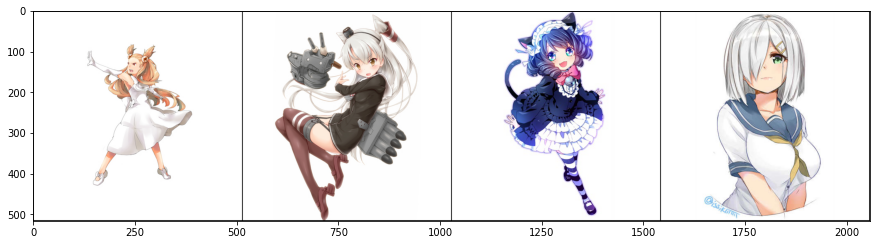

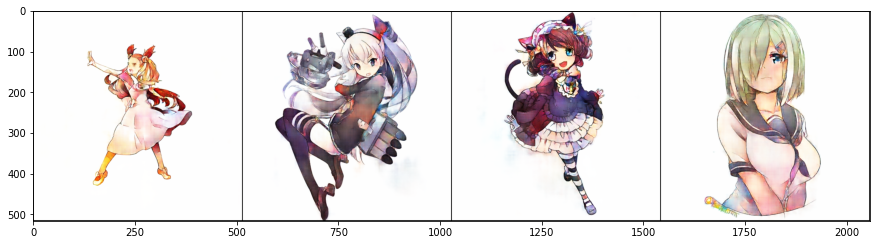


FID :  18.199463


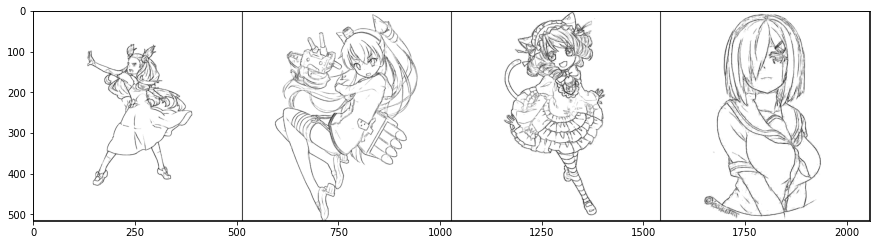

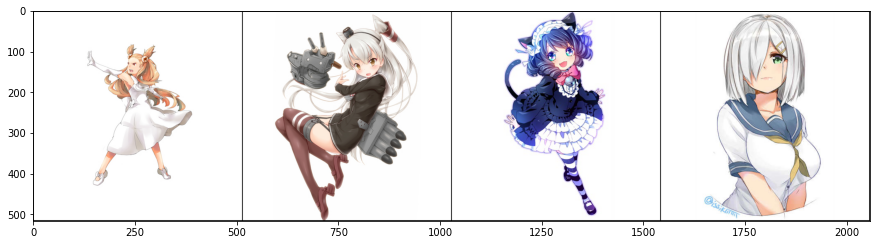

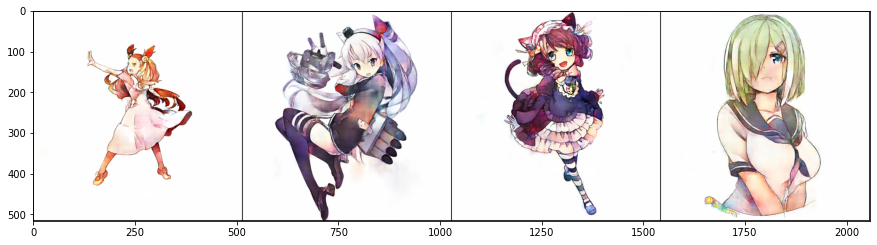


FID :  18.378265


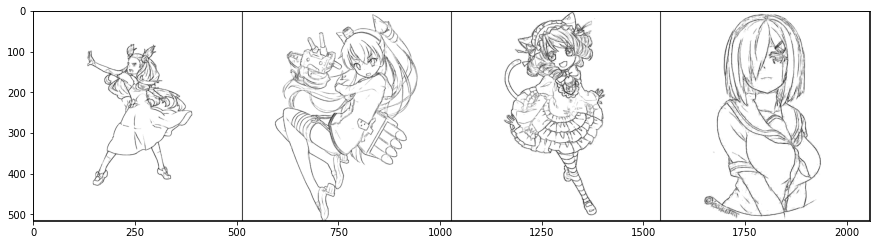

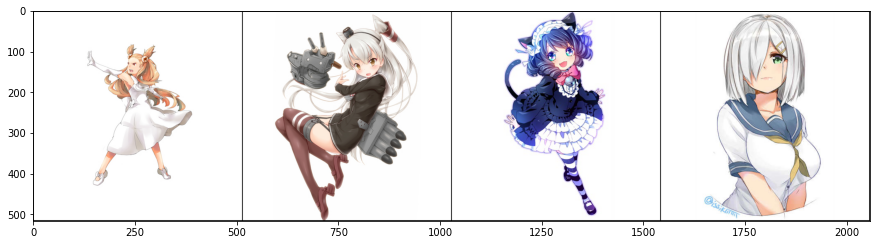

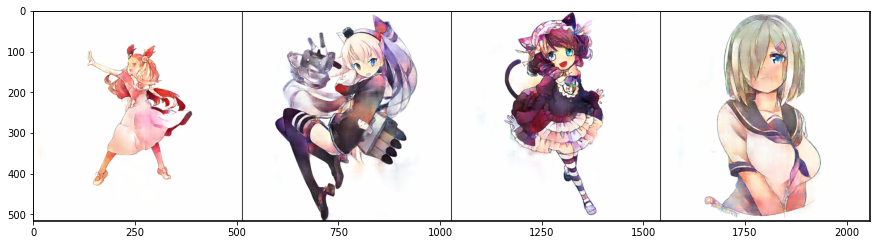


FID :  19.25354


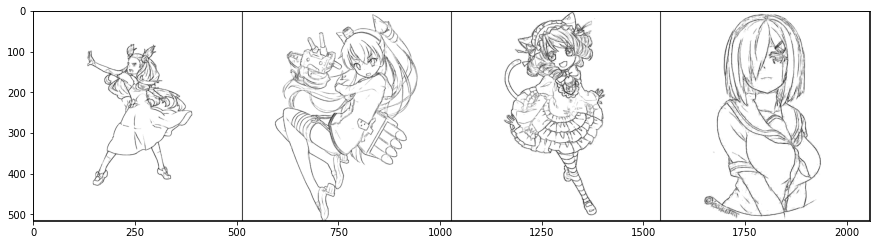

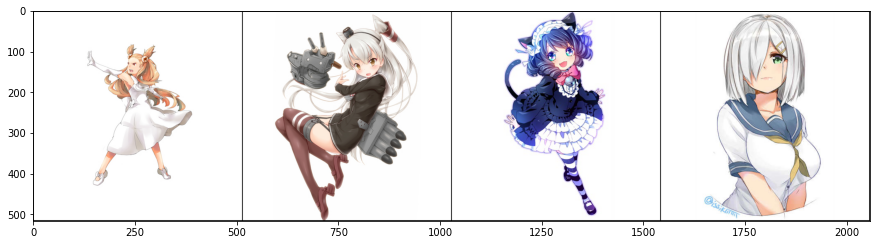

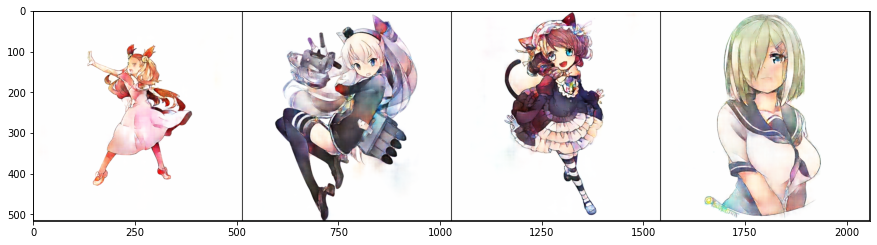


FID :  19.839111


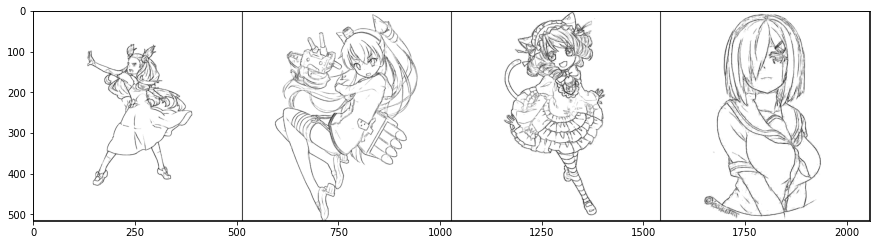

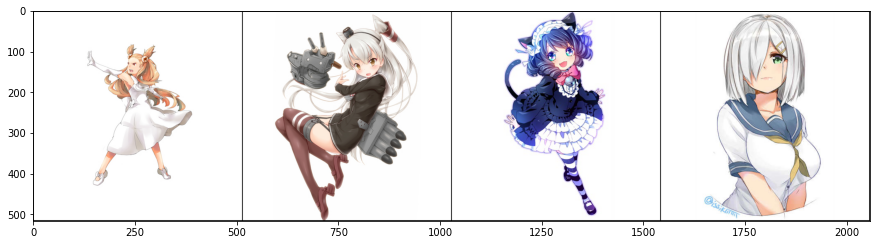

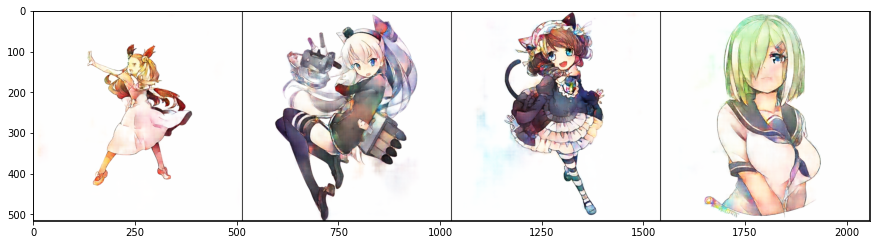


FID :  20.191925


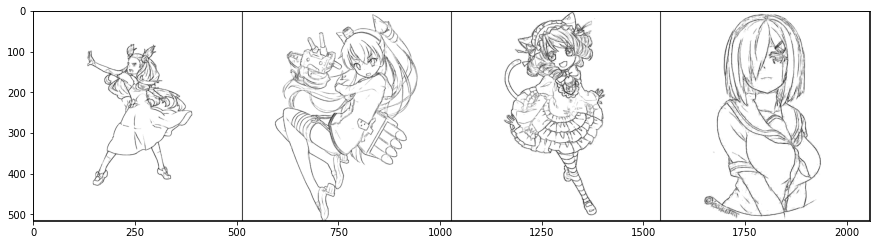

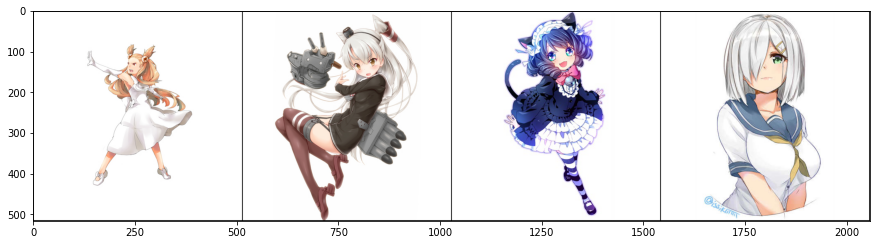

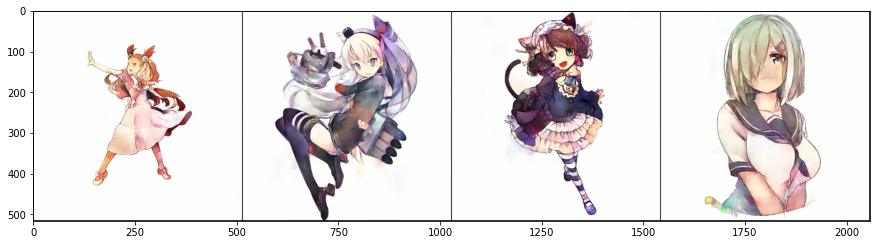


FID :  18.72815


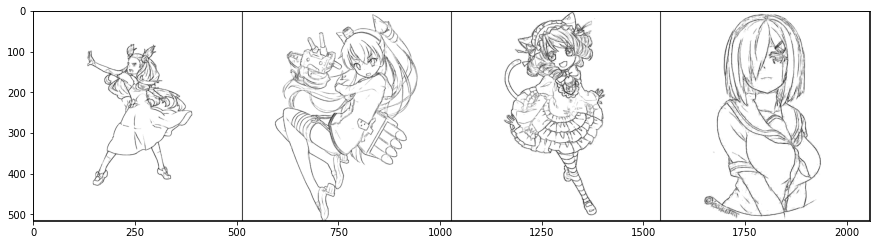

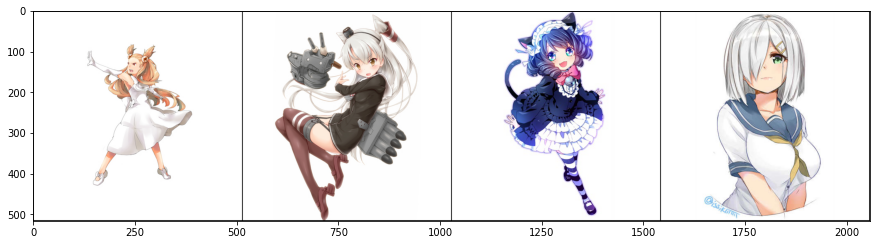

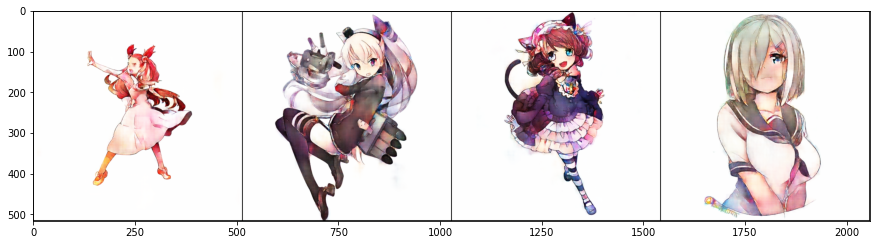


FID :  21.308838


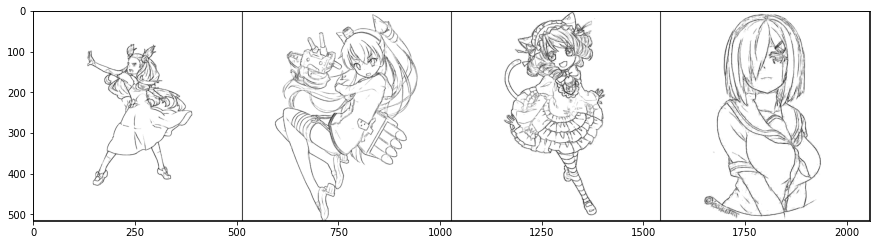

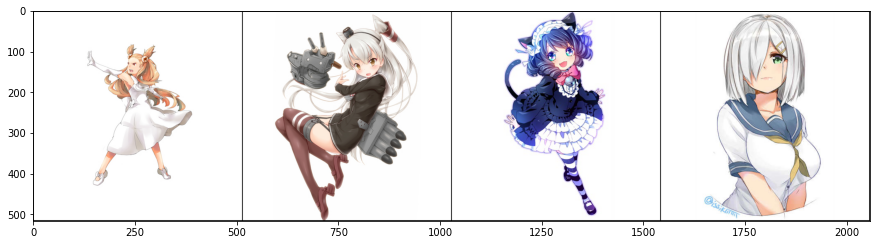

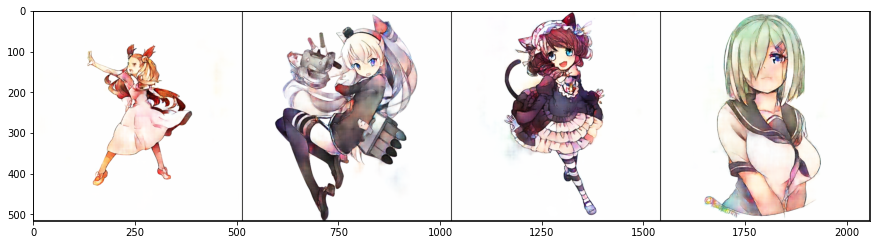


FID :  19.709778


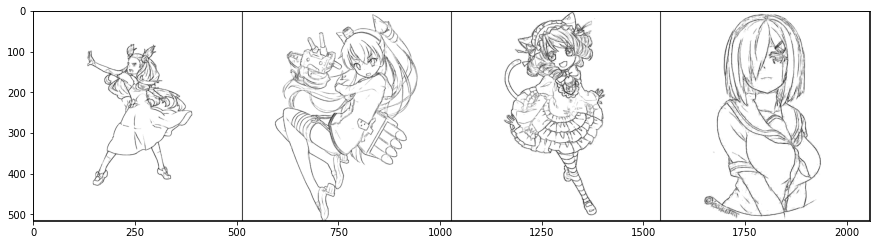

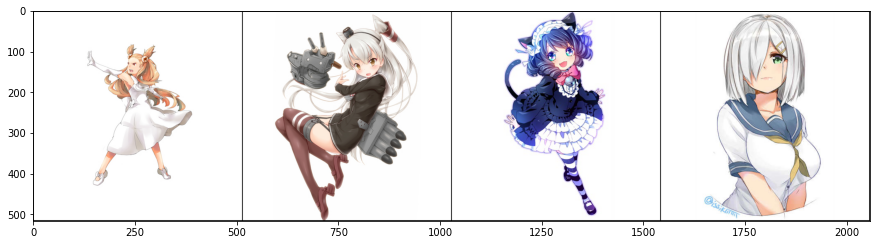

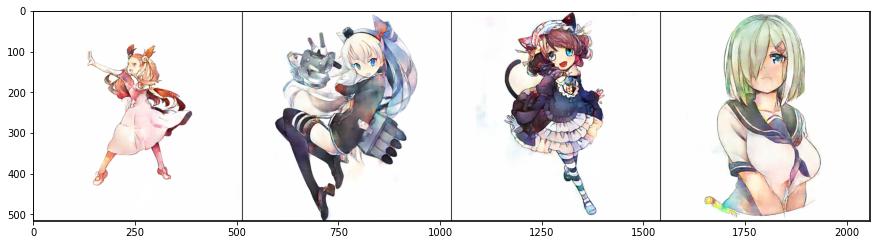


FID :  18.197815


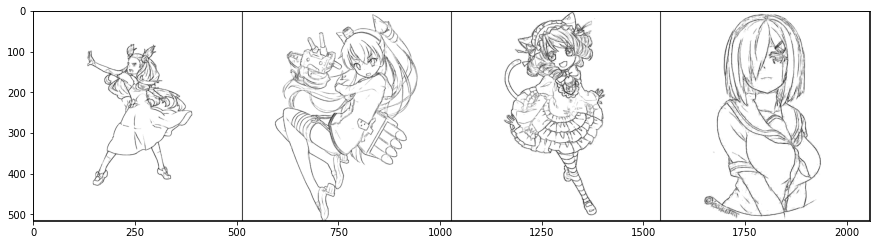

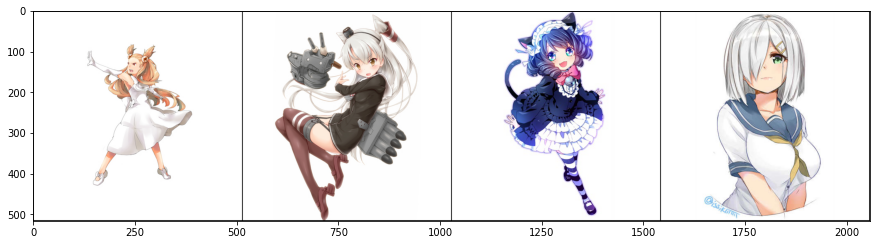

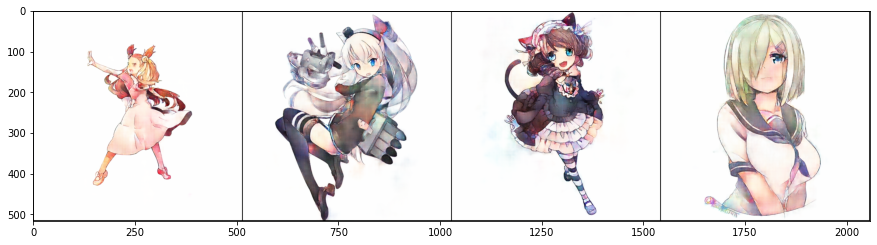


FID :  21.103607


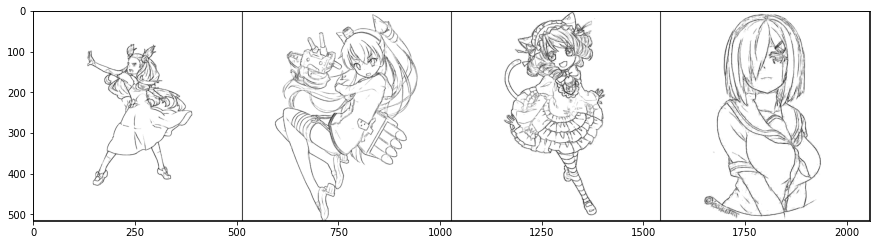

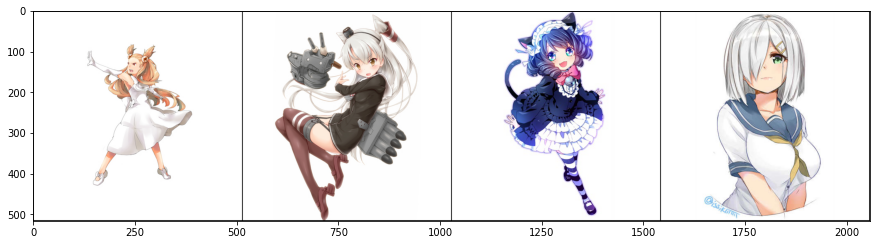

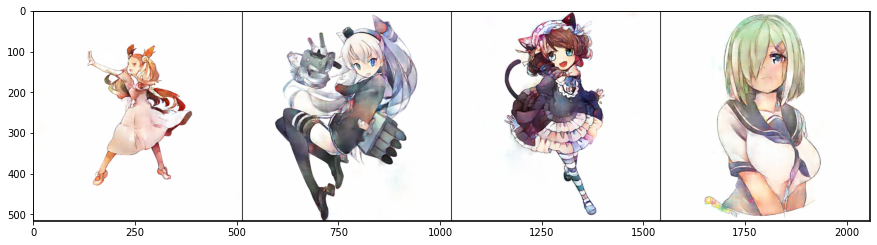


FID :  20.092743


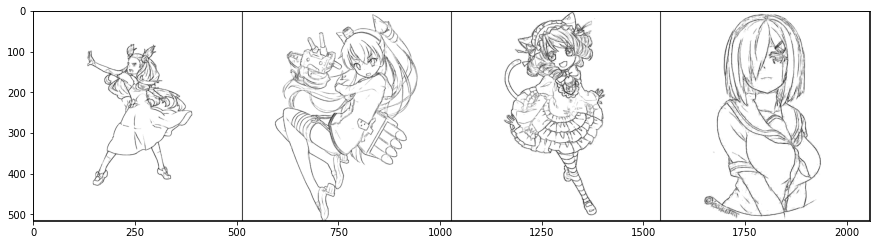

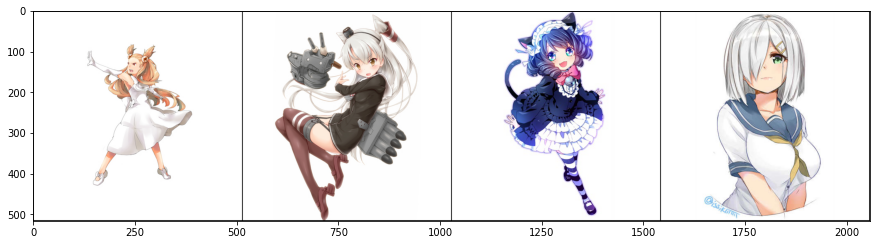

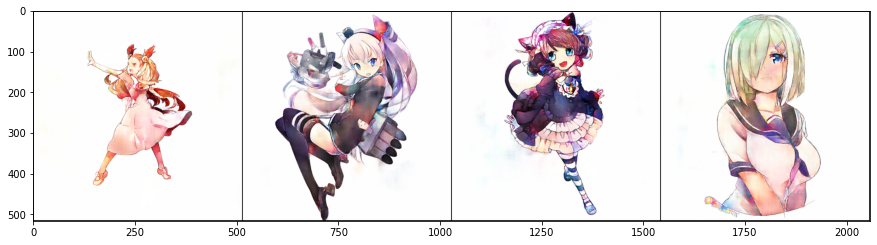


FID :  18.807404


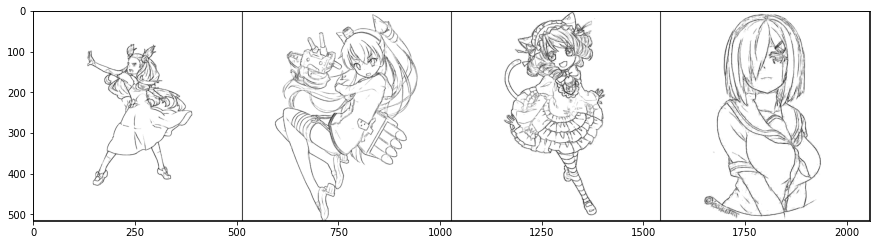

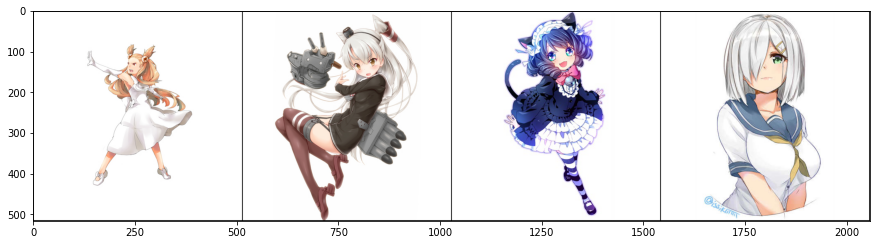

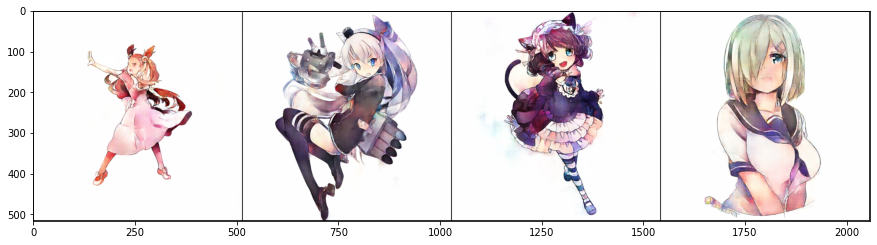


FID :  20.214325


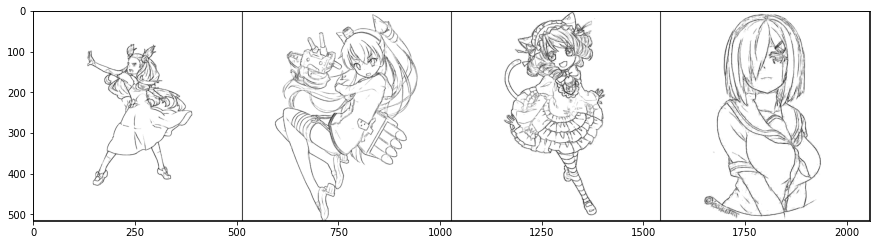

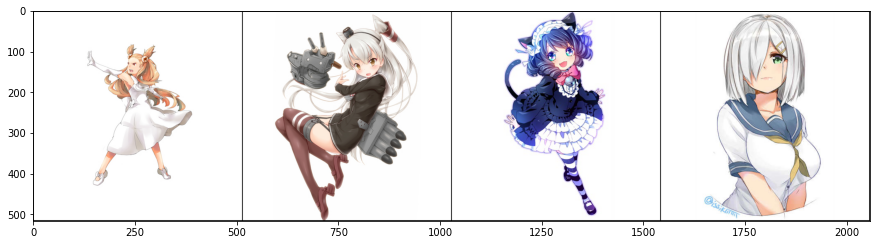

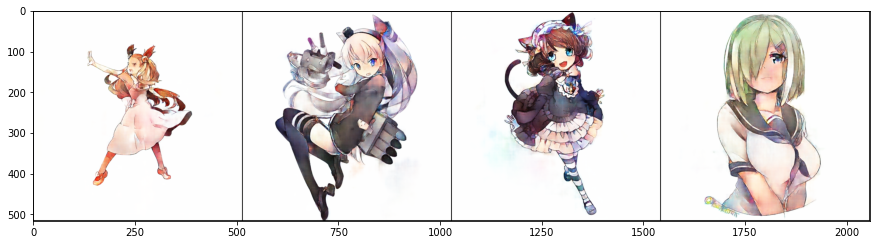


FID :  20.334106


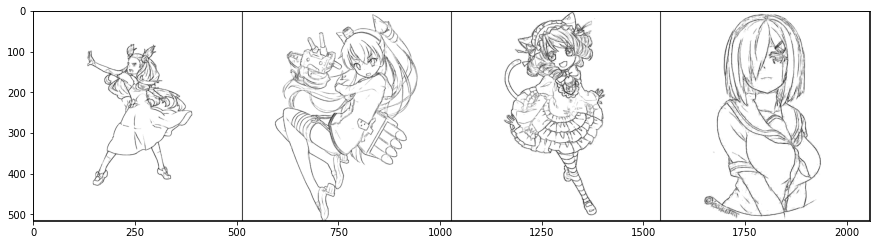

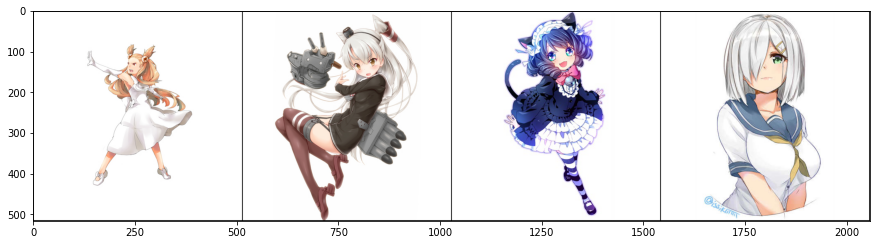

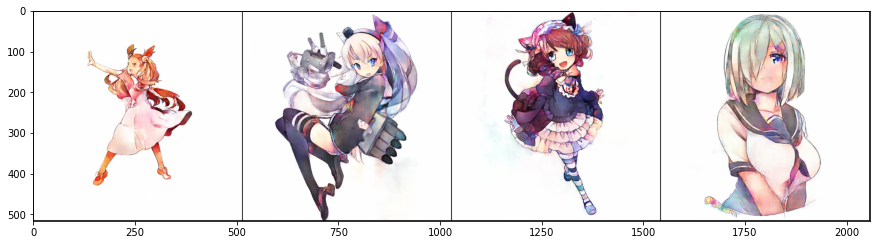


FID :  19.23642


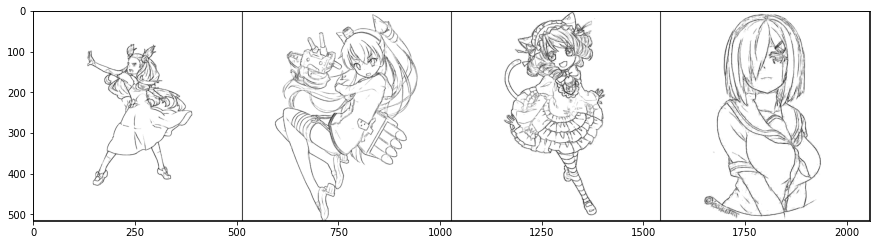

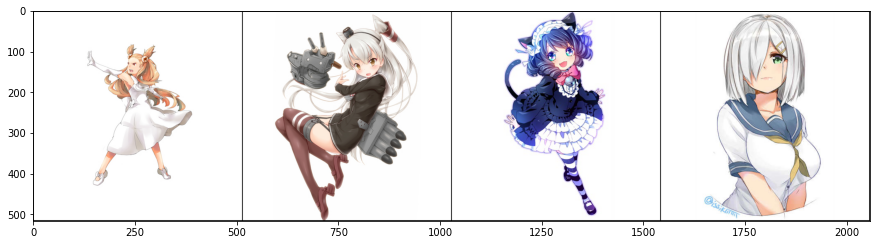

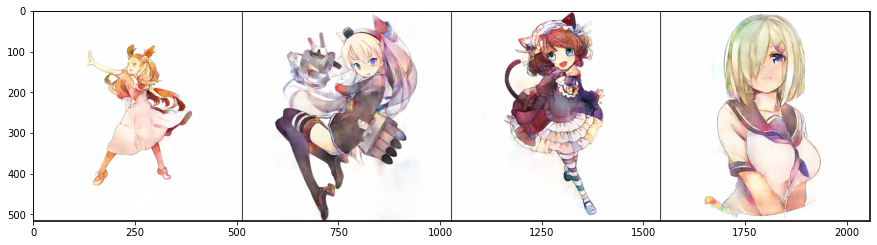


FID :  21.049377


In [ ]:
best_fid = np.inf
for e in range(40, 60):
  loss_generator = 0.
  loss_discriminator = 0.
  curr = 0
  t = tqdm(dataloader)
  correct_f = 0
  total_f = 0
  correct_r = 0
  total_r = 0
  for i, (conditions, reals) in enumerate(t):
    conditions = nn.functional.interpolate(conditions, resize) 
    reals = nn.functional.interpolate(reals, resize)

    #print(conditions.shape)
    conditions = conditions.to(device)
    reals = reals.to(device)
    

    

    # update discriminator
    if i % 2 == 0:
      optimizer_disc.zero_grad()

      with torch.no_grad():
        # generate fake image 
        fakes = gen(conditions)
      preds_fakes = disc( create_inputs_disc(fakes, conditions) )
      preds_reals = disc( create_inputs_disc(reals, conditions) )
      loss_disc = get_disc_loss(preds_reals, preds_fakes)
      loss_disc.backward()
      optimizer_disc.step()
      loss_discriminator += loss_disc.item()
      ## acc
      correct_f += (torch.round(preds_fakes).cpu().detach().numpy() == 0).sum() 
      correct_r += (torch.round(preds_reals).cpu().detach().numpy() == 1).sum()
      total_f += len(preds_fakes) 
      total_r += len(preds_reals)
      curr += 1

    # update generator
    optimizer_gen.zero_grad()

    # generate fake image 
    fakes = gen(conditions)

    preds_fakes = disc( create_inputs_disc(fakes, conditions) ) 
    loss_gen = get_gen_loss(preds_fakes, alpha, fakes, reals) + features_loss(fakes, reals, vgg, alpha=alpha_features) + total_variation_loss(fakes, alpha=alpha_variation)
    #print(torch.isnan(preds_fakes).sum(), torch.isnan(fakes).sum(), features_loss(fakes, reals, vgg, alpha=alpha_features) ,  total_variation_loss(fakes, alpha=alpha_variation))
    loss_gen.backward()
    optimizer_gen.step()

    
    loss_generator += loss_gen.item()
    

    t.set_description("Loss : {0} / {1} | acc disc f/r: {2}/{3}".format(round(loss_generator/(i+1),4), round(loss_discriminator/curr, 4),
                                                                 round(correct_f/total_f, 3 ) , round(correct_r/total_r, 3 )))
    t.refresh()      
  loss_generator /= curr
  loss_discriminator /= curr
  
  hist_g.append(loss_generator)
  hist_d.append(loss_discriminator)

  # show image
  # print("Num epochs : {0}".format(e+1))
  # im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
  # im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
  # im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255
  # im_v = cv2.vconcat([im1.astype(np.uint8), im2.astype(np.uint8), im3.astype(np.uint8)])
  try: 
    os.makedirs("drive/MyDrive/GAN_{0}".format(resize))
  except:
    pass
  # cv2.imwrite("drive/MyDrive/GAN_{0}/image_{1}.jpg".format(resize, e), im_v[:, :, ::-1])
  
  if e%evaluation_every_e == 0 and e >= 0:
    conditions, reals, fakes = inference(gen, val_dataset, ids=[0,260,310,477], device=device)
    im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
    im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
    im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255
    im_v = cv2.vconcat([im1.astype(np.uint8), im2.astype(np.uint8), im3.astype(np.uint8)])
    cv2.imwrite("drive/MyDrive/GAN_{0}/val_image_{1}.jpg".format(resize, e), im_v[:, :, ::-1])
    val_results = evaluate(gen, val_dataloader, fid)
    hist_fid.append(val_results)
    print("FID : ", val_results)
    if val_results < best_fid :
      best_fid = val_results
      torch.save(gen.state_dict(), "drive/MyDrive/pix2pixgen512_3.pth")
      torch.save(disc.state_dict(), "drive/MyDrive/pix2pixdisc512_3.pth")

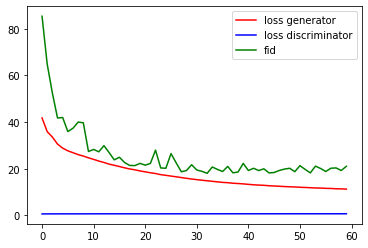

In [ ]:
# Display figure

t = list(range(len(hist_g)))
plt.figure()
plt.plot(t, hist_g, 'r', label="loss generator") # plotting t, a separately 
plt.plot(t, hist_d, 'b', label="loss discriminator") # plotting t, b separately 
plt.plot(t, hist_fid, 'g', label="fid") # plotting t, c separately 
plt.legend(loc='best')
plt.show()

# Display more images from Validation

In [ ]:
gen.load_state_dict(torch.load("drive/MyDrive/pix2pixgen512_3.pth"))

<All keys matched successfully>

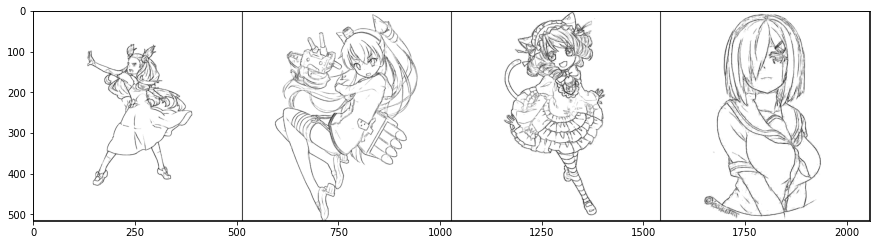

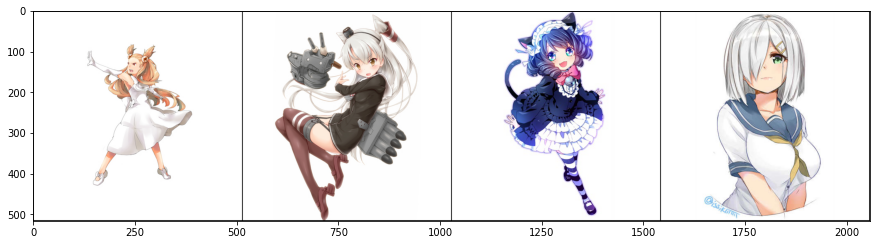

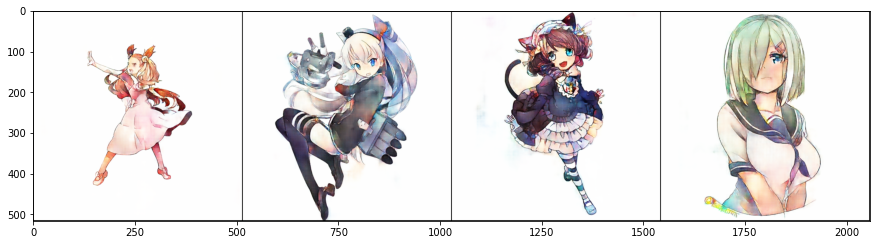

In [ ]:
conditions, reals, fakes = inference(gen, val_dataset, ids=[0,260,310,477], device=device)
im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255

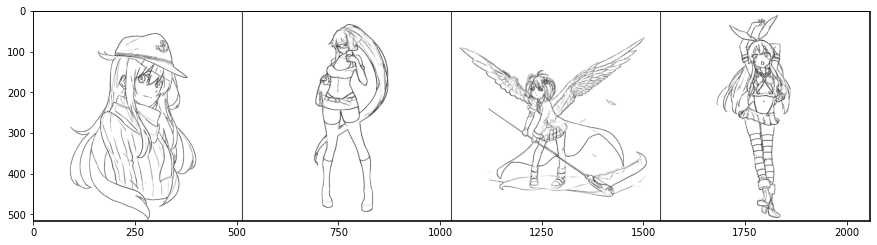

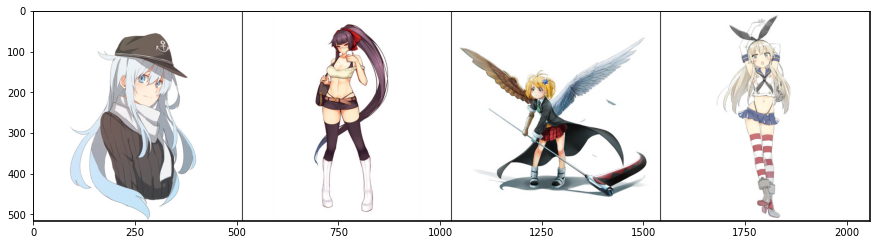

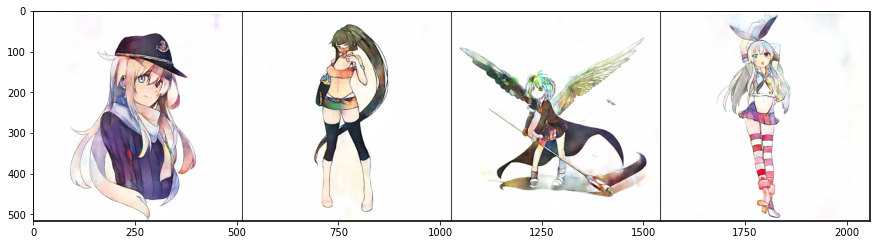

In [ ]:
conditions, reals, fakes = inference(gen, val_dataset, ids=[5, 6, 7, 8], device=device)
im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255

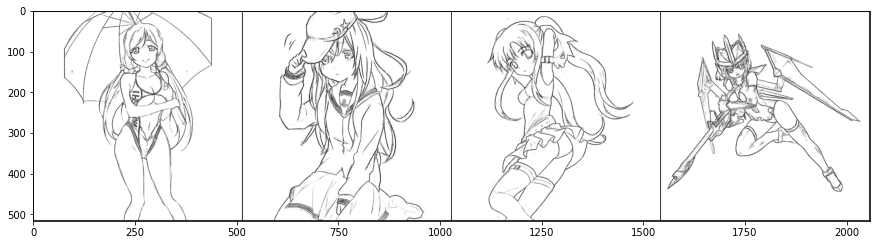

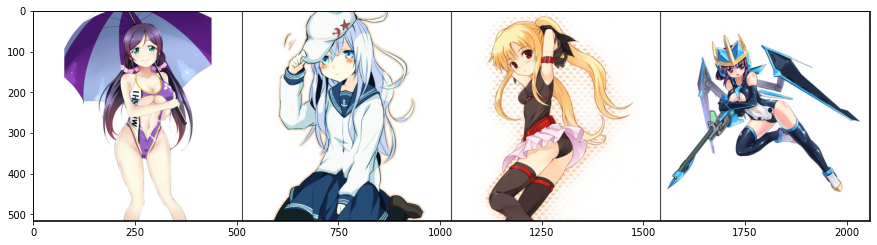

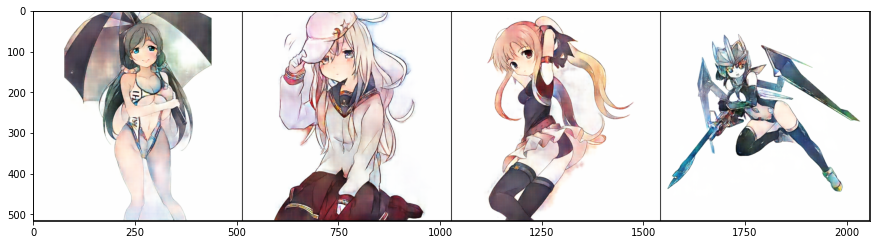

In [ ]:
conditions, reals, fakes = inference(gen, val_dataset, ids=[11, 15, 17, 18], device=device)
im1 = show_tensor_images(to_image_mat(conditions), size=(3, resize, resize)) * 255
im2 = show_tensor_images(to_image_mat(reals), size=(3, resize, resize)) * 255
im3 = show_tensor_images(to_image_mat(fakes), size=(3, resize, resize)) *255